In [1]:
import numpy as np
import pandas as pd

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set()

import warnings
warnings.filterwarnings('ignore')

In [3]:
import numpy as np
import pandas as pd
import scipy
from scipy import stats

In [4]:
pd.options.display.max_columns = None

### Basic Data Information

In [5]:
df = pd.read_csv("train.csv")
df.head()

,ID,Gender,DOB,Lead_Creation_Date,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved
0,APPC90493171225,Female,23/07/79,15/07/16,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
1,APPD40611263344,Male,07/12/86,04/07/16,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0
2,APPE70289249423,Male,10/12/82,19/07/16,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0
3,APPF80273865537,Male,30/01/89,09/07/16,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0
4,APPG60994436641,Male,19/04/85,20/07/16,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0


In [6]:
df.shape

(69713, 22)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69713 entries, 0 to 69712
Data columns (total 22 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   69713 non-null  object 
 1   Gender                               69713 non-null  object 
 2   DOB                                  69698 non-null  object 
 3   Lead_Creation_Date                   69713 non-null  object 
 4   City_Code                            68899 non-null  object 
 5   City_Category                        68899 non-null  object 
 6   Employer_Code                        65695 non-null  object 
 7   Employer_Category1                   65695 non-null  object 
 8   Employer_Category2                   65415 non-null  float64
 9   Monthly_Income                       69713 non-null  float64
 10  Customer_Existing_Primary_Bank_Code  60322 non-null  object 
 11  Primary_Bank_Type           

In [8]:
df.isna().sum()

ID                                         0
Gender                                     0
DOB                                       15
Lead_Creation_Date                         0
City_Code                                814
City_Category                            814
Employer_Code                           4018
Employer_Category1                      4018
Employer_Category2                      4298
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code     9391
Primary_Bank_Type                       9391
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                              51
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
dtype: int

<AxesSubplot:>

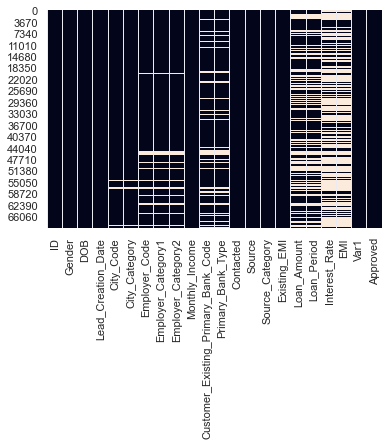

In [9]:
sns.heatmap(df.isna(), cbar=False)

In [10]:
df.isna().sum()/len(df)

ID                                     0.000000
Gender                                 0.000000
DOB                                    0.000215
Lead_Creation_Date                     0.000000
City_Code                              0.011676
City_Category                          0.011676
Employer_Code                          0.057636
Employer_Category1                     0.057636
Employer_Category2                     0.061653
Monthly_Income                         0.000000
Customer_Existing_Primary_Bank_Code    0.134709
Primary_Bank_Type                      0.134709
Contacted                              0.000000
Source                                 0.000000
Source_Category                        0.000000
Existing_EMI                           0.000732
Loan_Amount                            0.397472
Loan_Period                            0.397472
Interest_Rate                          0.680461
EMI                                    0.680461
Var1                                   0

In [11]:
# Most null values in Interest Rate, EMI followed by Loan Amount and Loan Period

#### Data Type Corrections

In [12]:
df1 = df.copy()
df1['DOB'] = pd.to_datetime(df1['DOB'])
df1['Lead_Creation_Date'] = pd.to_datetime(df1['Lead_Creation_Date'])

In [13]:
df1.head()

,ID,Gender,DOB,Lead_Creation_Date,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved
0,APPC90493171225,Female,1979-07-23,2016-07-15,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
1,APPD40611263344,Male,1986-07-12,2016-04-07,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0
2,APPE70289249423,Male,1982-10-12,2016-07-19,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0
3,APPF80273865537,Male,1989-01-30,2016-09-07,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0
4,APPG60994436641,Male,1985-04-19,2016-07-20,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0


In [14]:
df1.loc[df1['Existing_EMI'] != 0, ["Existing_EMI", 'EMI']]

,Existing_EMI,EMI
4,2500.0,NaN
10,460.0,508.0
11,255.0,722.0
13,1000.0,NaN
23,133.3,609.0
...,...,...
69701,500.0,NaN
69702,845.0,NaN
69704,3400.0,546.0
69709,1450.0,NaN


#### Numerical and Categorical columns

In [15]:
num = df1.select_dtypes(include=np.number).columns
cat = df1.select_dtypes(include='object').columns
print("Numerical cols:", len(num), num, sep="\n")
print("Categorical cols:", len(cat), cat, sep="\n")

Numerical cols:
9
Index(['Employer_Category2', 'Monthly_Income', 'Existing_EMI', 'Loan_Amount',
       'Loan_Period', 'Interest_Rate', 'EMI', 'Var1', 'Approved'],
      dtype='object')
Categorical cols:
11
Index(['ID', 'Gender', 'City_Code', 'City_Category', 'Employer_Code',
       'Employer_Category1', 'Customer_Existing_Primary_Bank_Code',
       'Primary_Bank_Type', 'Contacted', 'Source', 'Source_Category'],
      dtype='object')


#### Univariate Analysis

In [16]:
plt.rcParams['figure.figsize'] = (15, 8)

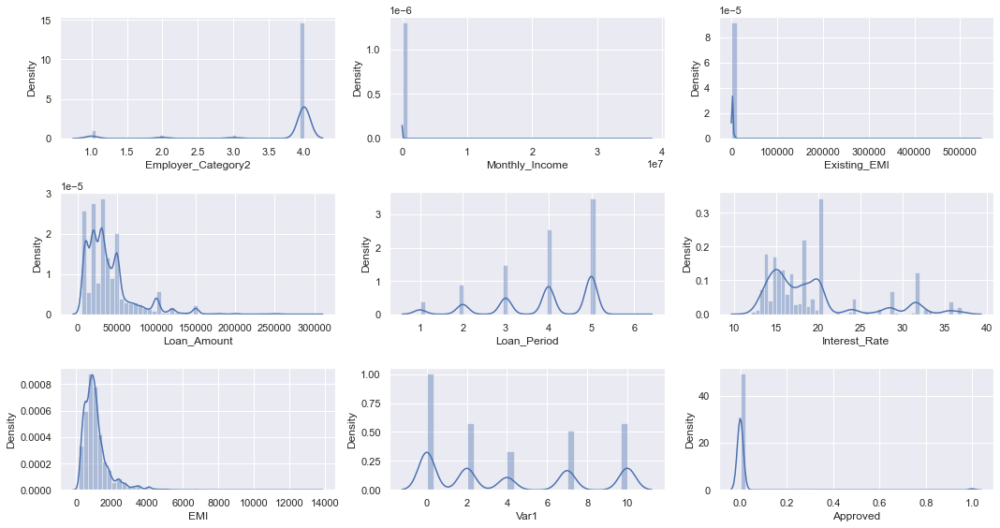

In [17]:
i = 1
for x in num:
    plt.subplot(3, 3, i)
    sns.distplot(df1[x])
    i += 1
plt.tight_layout()

#### Monthly Income is highly right skewed

<AxesSubplot:xlabel='Monthly_Income', ylabel='Density'>

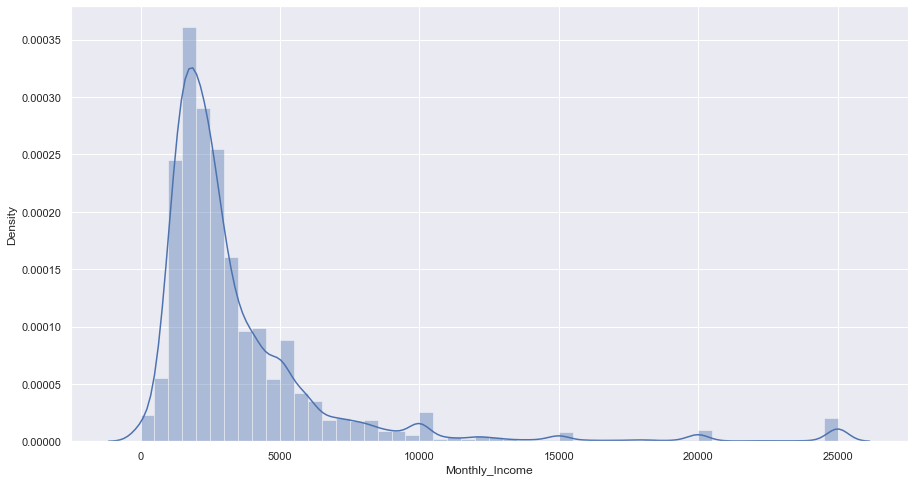

In [18]:
up = np.quantile(df1['Monthly_Income'], 0.99)

x = df1['Monthly_Income'].clip(upper=up)
sns.distplot(x)

In [19]:
# Few RICH people are skewing our data to the right (634)

In [20]:
df1.loc[df1['Monthly_Income'] > 25000, ['Monthly_Income', 'Employer_Category2', 'Existing_EMI', 'Loan_Amount', 'Approved']].sort_values(by='Monthly_Income', ascending=False).head(30)

,Monthly_Income,Employer_Category2,Existing_EMI,Loan_Amount,Approved
38774,38383838.3,4.0,0.0,150000.0,0
20442,12010013.2,NaN,545436.5,50000.0,0
22432,10000000.0,4.0,0.0,10000.0,0
54437,10000000.0,4.0,1150.0,150000.0,0
22509,10000000.0,4.0,0.0,150000.0,0
68021,10000000.0,4.0,3000.0,150000.0,0
3491,5495454.5,NaN,15000.0,100000.0,0
40108,5000000.0,4.0,0.0,50000.0,0
25179,4000078.5,4.0,785.6,20000.0,0
24171,2626262.6,4.0,0.0,20000.0,0


In [21]:
df1['Existing_EMI']

0           0.0
1           0.0
2           0.0
3           0.0
4        2500.0
          ...  
69708       0.0
69709    1450.0
69710       0.0
69711    1366.0
69712       0.0
Name: Existing_EMI, Length: 69713, dtype: float64

(<AxesSubplot:xlabel='Existing_EMI', ylabel='Density'>, nan)

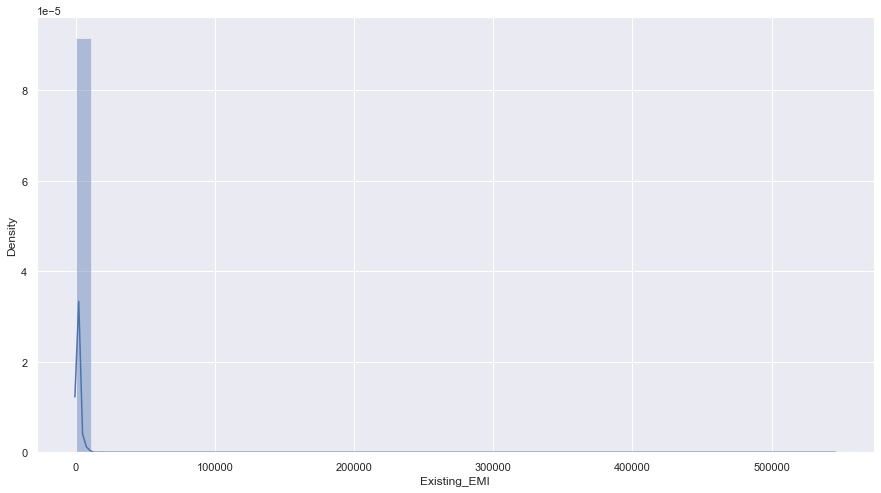

In [22]:
up = np.quantile(df1['Existing_EMI'], 0.01)

x = df1['Existing_EMI'].clip(upper=up)
sns.distplot(x), up

#### Most Existing EMI Values are 0

In [23]:
for x in cat:
    print(x, df1[x].nunique())

ID 69713
Gender 2
City_Code 678
City_Category 3
Employer_Code 36617
Employer_Category1 3
Customer_Existing_Primary_Bank_Code 57
Primary_Bank_Type 2
Contacted 2
Source 29
Source_Category 7


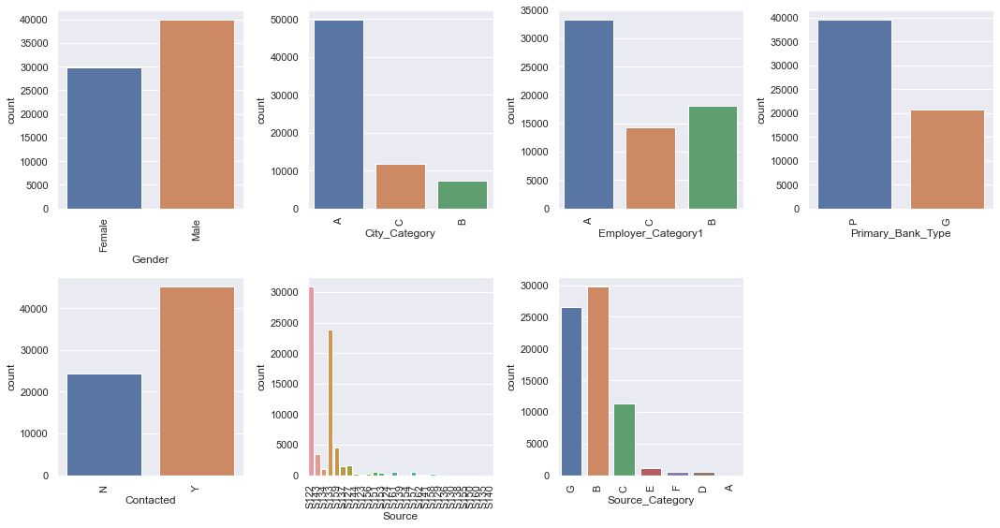

In [24]:
cat_new = cat.drop(["ID", "City_Code", "Employer_Code", "Customer_Existing_Primary_Bank_Code"])

i = 1
for x in cat_new:
    plt.subplot(2, 4, i)
    sns.countplot(df1[x])
    plt.xticks(rotation=90)
    i += 1
plt.tight_layout()

In [25]:
# Male applicants higher
# Most applicants from City Category A, employer Category1 A
# Private banks are higher
# Most leads are verified coming from Source Category B, C, G

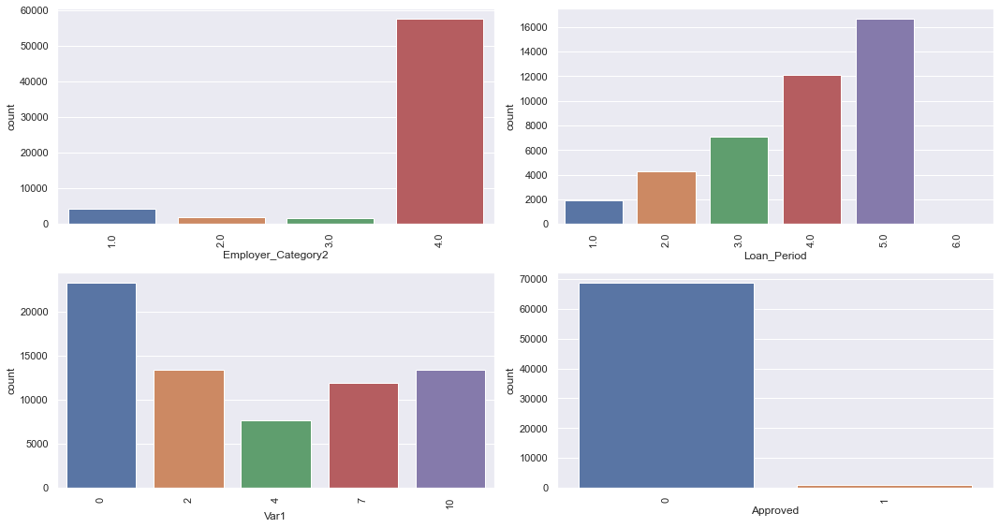

In [26]:
cat1 = ["Employer_Category2", "Loan_Period", "Var1", "Approved"]

i = 1
for x in cat1:
    plt.subplot(2, 2, i)
    sns.countplot(df1[x])
    plt.xticks(rotation=90)
    i += 1
plt.tight_layout()

#### EDA R&D

In [27]:
df1.loc[df1['Approved'] == 0, 'Approved'].shape[0]/len(df1)

0.9853685826173023

In [28]:
df1.loc[df1['Approved'] == 1, 'Primary_Bank_Type'].value_counts()

P    804
G    196
Name: Primary_Bank_Type, dtype: int64

In [29]:
# Higher chance of loan being approved by a Primary Bank

In [30]:
df1.groupby('Employer_Category1')['Employer_Category2'].value_counts()

Employer_Category1  Employer_Category2
A                   4.0                   30500
                    1.0                    2069
                    2.0                     291
                    3.0                     196
B                   4.0                   15612
                    2.0                    1113
                    3.0                     921
                    1.0                     410
C                   4.0                   11470
                    1.0                    1779
                    2.0                     551
                    3.0                     503
Name: Employer_Category2, dtype: int64

In [31]:
df1.loc[df1['Monthly_Income'] > 25000, ['Monthly_Income', 'Employer_Category1', 'Employer_Category2']].value_counts(['Employer_Category1', 'Employer_Category2'])

Employer_Category1  Employer_Category2
A                   4.0                   326
B                   4.0                   119
C                   4.0                    91
A                   1.0                    30
C                   1.0                    16
B                   2.0                    11
                    3.0                     6
                    1.0                     4
A                   2.0                     3
C                   2.0                     3
A                   3.0                     2
dtype: int64

In [32]:
df1.Monthly_Income.sort_values(ascending=False)

38774    38383838.3
20442    12010013.2
22432    10000000.0
54437    10000000.0
68021    10000000.0
            ...    
50069           0.0
50068           0.0
49264           0.0
49263           0.0
50825           0.0
Name: Monthly_Income, Length: 69713, dtype: float64

In [33]:
df1.loc[df1['Monthly_Income'] > 25000, ['ID', 'Monthly_Income']].sort_values(by='Monthly_Income', ascending=False).head(30)

,ID,Monthly_Income
38774,APPJ70184404909,38383838.3
20442,APPD50002916548,12010013.2
22432,APPA60086062823,10000000.0
54437,APPO90710036421,10000000.0
22509,APPO10994188022,10000000.0
68021,APPJ30744087518,10000000.0
3491,APPC80371942803,5495454.5
40108,APPW40887345212,5000000.0
25179,APPP60509993326,4000078.5
24171,APPY70484989831,2626262.6


<AxesSubplot:>

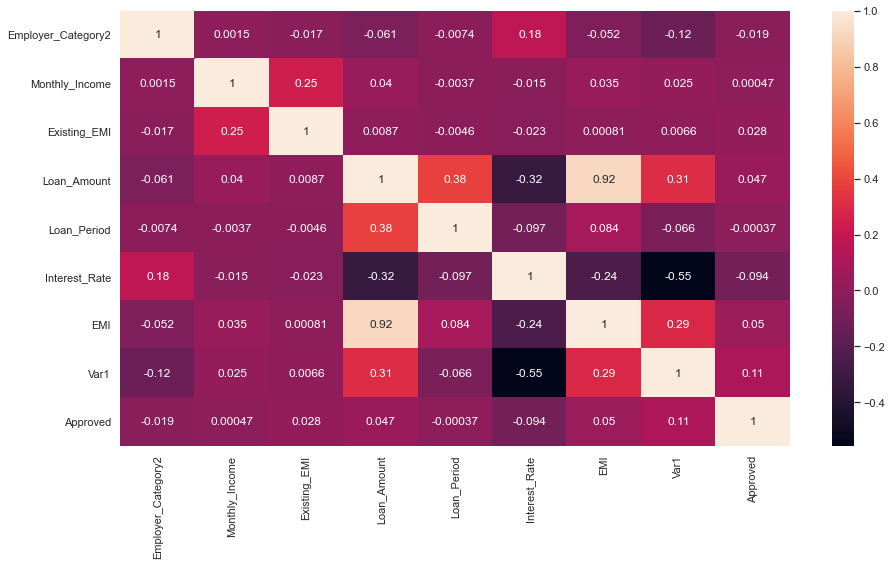

In [34]:
sns.heatmap(df.corr(), annot=True)

In [35]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

### Statistical Tests for Checking Relationships

##### Employer Category 2

In [36]:
model = ols("Interest_Rate ~ Employer_Category2", data=df1).fit()

sm.stats.anova_lm(model)

,df,sum_sq,mean_sq,F,PR(>F)
Employer_Category2,1.0,23865.181873,23865.181873,719.881741,4.478301e-156
Residual,22102.0,732715.138459,33.151531,NaN,NaN


In [37]:
model = ols("Monthly_Income ~ Employer_Category2", data=df1).fit()

sm.stats.anova_lm(model)

,df,sum_sq,mean_sq,F,PR(>F)
Employer_Category2,1.0,4.673236e+09,4.673236e+09,0.15639,0.692503
Residual,65413.0,1.954663e+15,2.988188e+10,NaN,NaN


In [38]:
import scipy.stats as stats

In [39]:
tbl = pd.crosstab(df1['Source_Category'], df1['Employer_Category2']).T

stats.chi2_contingency(tbl)

(174.41971782271395,
 1.217562691631264e-27,
 18,
 array([[1.95276313e-01, 1.93043654e+03, 7.26297699e+02, 2.74688680e+01,
         6.77608805e+01, 2.94867232e+01, 1.47635402e+03],
        [8.96583352e-02, 8.86332416e+02, 3.33469235e+02, 1.26119392e+01,
         3.11114423e+01, 1.35384086e+01, 6.77846901e+02],
        [7.42948865e-02, 7.34454483e+02, 2.76327448e+02, 1.04508140e+01,
         2.57803256e+01, 1.12185279e+01, 5.61694107e+02],
        [2.64077047e+00, 2.61057766e+04, 9.82190562e+03, 3.71468379e+02,
         9.16347352e+02, 3.98756340e+02, 1.99651050e+04]]))

In [40]:
tbl = pd.crosstab(df1['Primary_Bank_Type'], df1['Employer_Category2'])

stats.chi2_contingency(tbl)

(1221.5075293391658,
 1.5803505873225545e-264,
 3,
 array([[ 1414.60708718,   656.50084651,   531.97437015, 17805.91769616],
        [ 2720.39291282,  1262.49915349,  1023.02562985, 34242.08230384]]))

In [41]:
# Employer Category 2 affects Interest Rate, Bank Type and Source Category

In [42]:
df1.head()

,ID,Gender,DOB,Lead_Creation_Date,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved
0,APPC90493171225,Female,1979-07-23,2016-07-15,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
1,APPD40611263344,Male,1986-07-12,2016-04-07,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0
2,APPE70289249423,Male,1982-10-12,2016-07-19,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0
3,APPF80273865537,Male,1989-01-30,2016-09-07,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0
4,APPG60994436641,Male,1985-04-19,2016-07-20,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0


In [43]:
df1.isna().sum()

ID                                         0
Gender                                     0
DOB                                       15
Lead_Creation_Date                         0
City_Code                                814
City_Category                            814
Employer_Code                           4018
Employer_Category1                      4018
Employer_Category2                      4298
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code     9391
Primary_Bank_Type                       9391
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                              51
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
dtype: int

In [44]:
df1.City_Code.nunique()

678

In [45]:
df1.groupby('City_Category')['City_Code'].nunique()

City_Category
A     15
B     31
C    632
Name: City_Code, dtype: int64

In [46]:
df1.Employer_Code.nunique()

36617

In [47]:
df1.groupby('Employer_Category1')['Employer_Code'].nunique()

Employer_Category1
A    22447
B     8629
C     5541
Name: Employer_Code, dtype: int64

In [48]:
df1.loc[df1['City_Code'].isna(), :]

,ID,Gender,DOB,Lead_Creation_Date,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved
12711,APPL60213508703,Male,1989-12-27,2016-07-19,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
12715,APPQ30932694235,Male,1989-12-27,2016-07-19,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
12717,APPT30773935518,Male,1989-12-27,2016-07-19,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
12727,APPF40116522716,Male,1989-12-27,2016-07-19,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
32212,APPR30962498932,Male,1987-12-03,2016-08-16,NaN,NaN,NaN,NaN,NaN,4166.7,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69171,APPC10625766808,Female,1991-11-16,2016-09-30,NaN,NaN,NaN,NaN,NaN,2665.5,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
69173,APPF80467543148,Female,1986-10-10,2016-09-30,NaN,NaN,NaN,NaN,NaN,2000.0,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
69174,APPG20889519217,Female,1984-10-31,2016-09-30,NaN,NaN,NaN,NaN,NaN,5000.0,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0
69175,APPH90191078331,Female,1992-07-08,2016-09-30,NaN,NaN,NaN,NaN,NaN,2700.0,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0


In [49]:
df1.isna().sum(axis=1)

0        4
1        0
2        2
3        2
4        2
        ..
69708    4
69709    4
69710    0
69711    2
69712    2
Length: 69713, dtype: int64

In [50]:
df1.loc[df1.City_Code.isna(),['City_Code','City_Category','Employer_Category1','Employer_Category2']].isnull().sum()

City_Code             814
City_Category         814
Employer_Category1    457
Employer_Category2    457
dtype: int64

In [51]:
df1['DOB_year'] = df1.DOB.dt.year
df1

,ID,Gender,DOB,Lead_Creation_Date,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,DOB_year
0,APPC90493171225,Female,1979-07-23,2016-07-15,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,1979.0
1,APPD40611263344,Male,1986-07-12,2016-04-07,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,1986.0
2,APPE70289249423,Male,1982-10-12,2016-07-19,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,1982.0
3,APPF80273865537,Male,1989-01-30,2016-09-07,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,1989.0
4,APPG60994436641,Male,1985-04-19,2016-07-20,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,1985.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69708,APPU90955789628,Female,1983-07-31,2016-09-30,C10006,A,COM0000010,A,1.0,4900.0,B002,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,10,0,1983.0
69709,APPV80989824738,Female,2071-01-27,2016-09-30,C10116,C,COM0045789,A,4.0,7190.1,B002,P,N,S122,G,1450.0,NaN,NaN,NaN,NaN,7,0,2071.0
69710,APPW50697209842,Female,1992-01-02,2016-09-30,C10022,B,COM0013284,C,4.0,1600.0,B030,P,Y,S122,G,0.0,24000.0,4.0,35.50,943.0,2,0,1992.0
69711,APPY50870035036,Male,1978-06-27,2016-09-30,C10002,A,COM0000098,C,3.0,9893.0,B002,P,Y,S122,G,1366.0,80000.0,5.0,NaN,NaN,10,0,1978.0


In [52]:
df1.loc[df1['DOB_year'] > 2016, 'DOB_year'] = df1.DOB_year - 100
df1.head()

,ID,Gender,DOB,Lead_Creation_Date,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,DOB_year
0,APPC90493171225,Female,1979-07-23,2016-07-15,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,1979.0
1,APPD40611263344,Male,1986-07-12,2016-04-07,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,1986.0
2,APPE70289249423,Male,1982-10-12,2016-07-19,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,1982.0
3,APPF80273865537,Male,1989-01-30,2016-09-07,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,1989.0
4,APPG60994436641,Male,1985-04-19,2016-07-20,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,1985.0


### Feature Engineering for Age

In [53]:
df1['Age'] = df1['Lead_Creation_Date'].dt.year - df1.DOB_year
df1['Lead_Creation_Month'] = df1['Lead_Creation_Date'].dt.month

df2 = df1.drop(["DOB_year", 'DOB', 'Lead_Creation_Date'], axis=1)
df2.head()

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month
0,APPC90493171225,Female,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,37.0,7
1,APPD40611263344,Male,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,30.0,4
2,APPE70289249423,Male,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,34.0,7
3,APPF80273865537,Male,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,27.0,9
4,APPG60994436641,Male,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,31.0,7


In [54]:
df1.groupby('Lead_Creation_Month')['Approved'].value_counts()

Lead_Creation_Month  Approved
1                    0            1967
                     1              27
2                    0            3173
                     1              27
3                    0            1965
                     1              38
4                    0            2255
                     1              43
5                    0            2435
                     1              41
6                    0            2188
                     1              32
7                    0           15251
                     1             215
8                    0           15653
                     1             266
9                    0           18214
                     1             232
10                   0            1581
                     1              35
11                   0            1778
                     1              22
12                   0            2233
                     1              42
Name: Approved, dtype: int64

In [55]:
df2.isna().sum()/len(df2)

ID                                     0.000000
Gender                                 0.000000
City_Code                              0.011676
City_Category                          0.011676
Employer_Code                          0.057636
Employer_Category1                     0.057636
Employer_Category2                     0.061653
Monthly_Income                         0.000000
Customer_Existing_Primary_Bank_Code    0.134709
Primary_Bank_Type                      0.134709
Contacted                              0.000000
Source                                 0.000000
Source_Category                        0.000000
Existing_EMI                           0.000732
Loan_Amount                            0.397472
Loan_Period                            0.397472
Interest_Rate                          0.680461
EMI                                    0.680461
Var1                                   0.000000
Approved                               0.000000
Age                                    0

##### Imputing Median of age to deal with the null values

In [56]:
df2.loc[df2.Age.isna(), 'Age'] = df2.Age.median()

#### Treating Null Values by Respictive Imputation via statistical tests 

In [57]:
df2.City_Category.value_counts()

A    49885
C    11694
B     7320
Name: City_Category, dtype: int64

In [58]:
tbl = pd.crosstab(df2['City_Category'], df2['Employer_Category1'])
stats.chi2_contingency(tbl)

(2046.6769818546622,
 0.0,
 4,
 array([[24120.43454039, 13056.41543971, 10351.1500199 ],
        [ 3467.74383973,  1877.09322293,  1488.16293734],
        [ 5570.82161988,  3015.49133735,  2390.68704276]]))

In [59]:
# there is a relation between City category and employer category 1

In [60]:
tbl = pd.crosstab(df2['City_Category'], df2['Source_Category'])
stats.chi2_contingency(tbl)

(1475.2909813252159,
 8.084269710528494e-309,
 12,
 array([[2.17209248e+00, 2.15848070e+04, 8.23512663e+03, 3.59843321e+02,
         7.60232369e+02, 3.32330150e+02, 1.86104884e+04],
        [3.18727413e-01, 3.16730054e+03, 1.20840186e+03, 5.28025080e+01,
         1.11554594e+02, 4.87652941e+01, 2.73085647e+03],
        [5.09180104e-01, 5.05989242e+03, 1.93047150e+03, 8.43541706e+01,
         1.78213036e+02, 7.79045559e+01, 4.36265513e+03]]))

In [61]:
tbl

Source_Category,A,B,C,D,E,F,G
City_Category,,,,,,,
A,2,21148,8806,303,773,341,18512
B,0,2563,1796,44,92,83,2742
C,1,6101,772,150,185,35,4450


In [62]:
df2.loc[(df2.Source_Category=='G') & (df2.City_Category.isna())]

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month
12711,APPL60213508703,Male,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,27.0,7
12715,APPQ30932694235,Male,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,27.0,7
12717,APPT30773935518,Male,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,27.0,7
12727,APPF40116522716,Male,NaN,NaN,NaN,NaN,NaN,7500.0,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,27.0,7
32212,APPR30962498932,Male,NaN,NaN,NaN,NaN,NaN,4166.7,NaN,NaN,Y,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,29.0,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69171,APPC10625766808,Female,NaN,NaN,NaN,NaN,NaN,2665.5,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,25.0,9
69173,APPF80467543148,Female,NaN,NaN,NaN,NaN,NaN,2000.0,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,30.0,9
69174,APPG20889519217,Female,NaN,NaN,NaN,NaN,NaN,5000.0,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,32.0,9
69175,APPH90191078331,Female,NaN,NaN,NaN,NaN,NaN,2700.0,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,24.0,9


In [63]:
df2.loc[(df2.Source_Category == 'G') & (df2.City_Category.isna()), 'City_Category'] = 'A'

##### Imputing City Category values basis Source Category

In [64]:
# Relation checked using Chisquare
# All missing values exist in source category 'G'
# Imputation with mode basis source category

In [65]:
df2.isna().sum()/len(df2)

ID                                     0.000000
Gender                                 0.000000
City_Code                              0.011676
City_Category                          0.000000
Employer_Code                          0.057636
Employer_Category1                     0.057636
Employer_Category2                     0.061653
Monthly_Income                         0.000000
Customer_Existing_Primary_Bank_Code    0.134709
Primary_Bank_Type                      0.134709
Contacted                              0.000000
Source                                 0.000000
Source_Category                        0.000000
Existing_EMI                           0.000732
Loan_Amount                            0.397472
Loan_Period                            0.397472
Interest_Rate                          0.680461
EMI                                    0.680461
Var1                                   0.000000
Approved                               0.000000
Age                                    0

In [66]:
df2.isna().sum()

ID                                         0
Gender                                     0
City_Code                                814
City_Category                              0
Employer_Code                           4018
Employer_Category1                      4018
Employer_Category2                      4298
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code     9391
Primary_Bank_Type                       9391
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                              51
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
Age                                        0
Lead_Creation_Month                        0
dtype: int

In [67]:
tbl = pd.crosstab(df2['Employer_Category1'], df2['Source_Category'])
stats.chi2_contingency(tbl), tbl

((151.83297537395342,
  2.4074505285129245e-26,
  12,
  array([[1.52230763e+00, 1.51068735e+04, 5.66653645e+03, 2.18197428e+02,
          5.31792800e+02, 2.29868453e+02, 1.15812090e+04],
         [8.24537636e-01, 8.18243665e+03, 3.06920393e+03, 1.18183728e+02,
          2.88038481e+02, 1.24505183e+02, 6.27280749e+03],
         [6.53154730e-01, 6.48168982e+03, 2.43125962e+03, 9.36188447e+01,
          2.28168719e+02, 9.86263643e+01, 4.96898347e+03]])),
 Source_Category     A      B     C    D    E    F      G
 Employer_Category1                                      
 A                   2  15404  5428  291  479  249  11483
 B                   1   8297  3017   64  303  114   6260
 C                   0   6070  2722   75  266   90   5080)

In [68]:
df2.loc[(df2.Source_Category=='F') & (df2.Employer_Category1.isna())]

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month
517,APPR20547696718,Female,C10029,C,NaN,NaN,NaN,133.3,B003,G,N,S133,F,0.0,NaN,NaN,NaN,NaN,0,0,23.0,2
6103,APPB70673449948,Female,C10003,A,NaN,NaN,NaN,275.0,B003,G,N,S122,F,0.0,NaN,NaN,NaN,NaN,0,0,29.0,9
6259,APPS20087734835,Female,C10028,C,NaN,NaN,NaN,250.0,B002,P,N,S133,F,0.0,NaN,NaN,NaN,NaN,0,0,31.0,10
8003,APPS50767117236,Female,C10002,A,NaN,NaN,NaN,225.0,B001,P,N,S133,F,0.0,NaN,NaN,NaN,NaN,0,0,28.0,12
9041,APPI50827547204,Female,C10001,A,NaN,NaN,NaN,166.7,B001,P,N,S122,F,0.0,NaN,NaN,NaN,NaN,0,0,31.0,7
21071,APPX20618529942,Male,C10003,A,NaN,NaN,NaN,2500.0,NaN,NaN,Y,S122,F,0.0,NaN,NaN,NaN,NaN,0,0,23.0,7


In [69]:
df2['Employer_Category1'] = df2['Employer_Category1'].fillna('A')

##### Imputing Employer Category1 basis Source Category

In [70]:
# Relation checked using Chisquare
# Most missing values exist in source category 'G'
# Imputation with mode basis source category

In [71]:
tbl = pd.crosstab(df2['Employer_Category1'], df2['Employer_Category2'])
stats.chi2_contingency(tbl), tbl

((3620.8921746851556,
  0.0,
  6,
  array([[ 2151.68459833,   987.91530994,   818.63058931, 29097.76950241],
         [ 1175.30303447,   539.62363372,   447.15615684, 15893.91717496],
         [  931.01236719,   427.46105633,   354.21325384, 12590.31332263]])),
 Employer_Category2   1.0   2.0  3.0    4.0
 Employer_Category1                        
 A                   2069   291  196  30500
 B                    410  1113  921  15612
 C                   1779   551  503  11470)

In [72]:
df2.loc[(df2.Employer_Category1=='C') & (df2.Employer_Category2.isna())]

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month


In [73]:
df2.groupby('Employer_Category1')['Employer_Category2'].value_counts()

Employer_Category1  Employer_Category2
A                   4.0                   30500
                    1.0                    2069
                    2.0                     291
                    3.0                     196
B                   4.0                   15612
                    2.0                    1113
                    3.0                     921
                    1.0                     410
C                   4.0                   11470
                    1.0                    1779
                    2.0                     551
                    3.0                     503
Name: Employer_Category2, dtype: int64

In [74]:
df2.groupby('Source_Category')['Employer_Category2'].value_counts()

Source_Category  Employer_Category2
A                4.0                       3
B                4.0                   26545
                 1.0                    1670
                 2.0                     799
                 3.0                     643
C                4.0                    9518
                 1.0                     897
                 2.0                     392
                 3.0                     351
D                4.0                     361
                 1.0                      38
                 3.0                      17
                 2.0                       6
E                4.0                     913
                 1.0                      66
                 2.0                      32
                 3.0                      30
F                4.0                     375
                 1.0                      43
                 2.0                      23
                 3.0                      12
G                4.

In [75]:
df2['Employer_Category2'] = df2['Employer_Category2'].fillna(4)

##### Imputing Employer category 2 basis Employer category1

In [76]:
# Relation checked using Chisquare
# All missing values exist in Employer category1 'A'
# Imputation with mode basis Employer category1

In [77]:
df2.isna().sum()

ID                                         0
Gender                                     0
City_Code                                814
City_Category                              0
Employer_Code                           4018
Employer_Category1                         0
Employer_Category2                         0
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code     9391
Primary_Bank_Type                       9391
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                              51
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
Age                                        0
Lead_Creation_Month                        0
dtype: int

#### Checking Relationships for Primary_Bank_Type to treate null values

In [78]:
df2.Customer_Existing_Primary_Bank_Code.str[-2:].unique()

array(['01', '02', '03', '14', '06', '17', nan, '04', '23', '11', '22',
       '09', '21', '16', '33', '43', '05', '28', '08', '47', '24', '32',
       '10', '20', '31', '25', '18', '07', '12', '39', '15', '26', '30',
       '37', '45', '41', '13', '44', '19', '36', '42', '27', '38', '34',
       '35', '40', '29', '46', '55', '49', '48', '50', '51', '56', '53',
       '54', '52', '57'], dtype=object)

In [79]:
# Check primary bank code for null value imputation, 58 values including nan (1-57)

In [80]:
df1.groupby('Primary_Bank_Type')['Customer_Existing_Primary_Bank_Code'].nunique()

Primary_Bank_Type
G    31
P    26
Name: Customer_Existing_Primary_Bank_Code, dtype: int64

In [81]:
ols("Monthly_Income ~ Primary_Bank_Type", data=df2).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         Monthly_Income   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.713
Date:                Tue, 22 Feb 2022   Prob (F-statistic):              0.191
Time:                        17:28:57   Log-Likelihood:            -8.1742e+05
No. Observations:               60322   AIC:                         1.635e+06
Df Residuals:                   60320   BIC:                         1.635e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
Intercept               4403.5982   1290.814      3.411      0.001    1873.599    6933.598
Primary_Bank_Type[T.P]  2084.4828   1592.758      1.309      0.191   -1037.328    5206.293
==============================================================================
Omnibus:                   277373.289   Durbin-Watson:                   2.000
Prob(Omnibus):                  0.000   Jarque-Bera (JB):    2427406517649.091
Skew:                         161.556   Prob(JB):                         0.00
Kurtosis:                   31078.315   Cond. No.                         3.17
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [82]:
tbl = pd.crosstab(df2['City_Category'], df2['Primary_Bank_Type'])
stats.chi2_contingency(tbl), tbl

((3442.434162218691,
  0.0,
  2,
  array([[15329.04731275, 29334.95268725],
         [ 2147.10997646,  4108.89002354],
         [ 3226.84271079,  6175.15728921]])),
 Primary_Bank_Type      G      P
 City_Category                  
 A                  12365  32299
 B                   3070   3186
 C                   5268   4134)

In [83]:
tbl = pd.crosstab(df2['Source_Category'], df2['Primary_Bank_Type'])
stats.chi2_contingency(tbl), tbl        ##lesser p-value

((215.3351187694544,
  1.0274949261913819e-43,
  6,
  array([[1.02962435e+00, 1.97037565e+00],
         [9.29064371e+03, 1.77793563e+04],
         [3.83569391e+03, 7.34030609e+03],
         [3.43208116e-01, 6.56791884e-01],
         [3.39089619e+02, 6.48910381e+02],
         [1.54786861e+02, 2.96213139e+02],
         [7.08141307e+03, 1.35515869e+04]])),
 Primary_Bank_Type     G      P
 Source_Category               
 A                     1      2
 B                  8971  18099
 C                  4477   6699
 D                     1      0
 E                   314    674
 F                   183    268
 G                  6756  13877)

##### Imputing primary_bank_type basis city category

In [84]:
df2.loc[(df2.City_Category=='A') & (df2.Primary_Bank_Type.isna())]

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month
112,APPV20785952136,Female,C10005,A,COM0000265,B,4.0,1700.0,NaN,NaN,N,S133,B,0.0,NaN,NaN,NaN,NaN,0,0,29.0,1
113,APPX70088104309,Male,C10005,A,COM0000265,B,4.0,2000.0,NaN,NaN,Y,S133,B,0.0,10000.0,2.0,NaN,NaN,4,0,29.0,1
131,APPP90838484136,Female,C10001,A,COM0055473,B,4.0,1800.0,NaN,NaN,N,S133,B,600.0,NaN,NaN,NaN,NaN,0,0,25.0,1
164,APPC50368689037,Male,C10006,A,COM0033955,A,4.0,20000.0,NaN,NaN,Y,S133,E,600.0,20000.0,5.0,15.50,481.0,10,0,41.0,1
171,APPJ60753287728,Male,C10006,A,COM0033973,C,4.0,19850.0,NaN,NaN,Y,S122,E,600.0,20000.0,5.0,15.50,481.0,10,0,41.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69619,APPP50413694745,Female,C10003,A,COM0053171,A,4.0,1500.0,NaN,NaN,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,30.0,9
69630,APPC10432434003,Female,C10003,A,COM0033144,B,4.0,1500.0,NaN,NaN,N,S122,G,199.2,NaN,NaN,NaN,NaN,0,0,29.0,9
69637,APPM60551988006,Male,C10001,A,COM0020197,A,4.0,4000.0,NaN,NaN,Y,S122,G,0.0,85000.0,4.0,15.25,2376.0,10,0,37.0,9
69698,APPD90796759944,Male,C10001,A,COM0009891,A,4.0,3200.0,NaN,NaN,Y,S122,G,NaN,50000.0,5.0,NaN,NaN,0,0,29.0,9


In [85]:
df2.loc[(df2['City_Category'] == 'A') & (df2['Primary_Bank_Type'].isna()), 'Primary_Bank_Type'] = 'P'
df2.loc[(df2['City_Category'] == 'B') & (df2['Primary_Bank_Type'].isna()), 'Primary_Bank_Type'] = 'P'
df2.loc[(df2['City_Category'] == 'C') & (df2['Primary_Bank_Type'].isna()), 'Primary_Bank_Type'] = 'G'

In [86]:
df2.isna().sum()

ID                                         0
Gender                                     0
City_Code                                814
City_Category                              0
Employer_Code                           4018
Employer_Category1                         0
Employer_Category2                         0
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code     9391
Primary_Bank_Type                          0
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                              51
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
Age                                        0
Lead_Creation_Month                        0
dtype: int

### R&D for Pattern & Relationship Checking in data

#### 1.City_Code / City_Category

In [87]:
df2.groupby('City_Code')['Customer_Existing_Primary_Bank_Code'].value_counts()

City_Code  Customer_Existing_Primary_Bank_Code
C10001     B001                                   2791
           B002                                   1728
           B003                                   1061
           B004                                    917
           B006                                    292
                                                  ... 
C10708     B003                                      1
C10712     B002                                      1
C10715     B010                                      1
C10720     B001                                      1
C10722     B009                                      1
Name: Customer_Existing_Primary_Bank_Code, Length: 3957, dtype: int64

In [88]:
df2.groupby('City_Category')['Customer_Existing_Primary_Bank_Code'].nunique()

City_Category
A    57
B    50
C    50
Name: Customer_Existing_Primary_Bank_Code, dtype: int64

In [89]:
df2.groupby(['City_Code','Gender'])['Employer_Code'].nunique().head(20)

City_Code  Gender
C10001     Female    2882
           Male      3737
C10002     Female    2370
           Male      3025
C10003     Female    3280
           Male      2813
C10004     Female    1667
           Male      2246
C10005     Female    1801
           Male      2046
C10006     Female    1123
           Male      1756
C10007     Female     667
           Male       987
C10008     Female     414
           Male       729
C10009     Female     277
           Male       538
C10010     Female     270
           Male       452
Name: Employer_Code, dtype: int64

In [90]:
df2.City_Code.nunique()

678

In [91]:
df2.Employer_Code.nunique()

36617

In [92]:
df2.groupby('Gender')['ID'].count()

Gender
Female    29764
Male      39949
Name: ID, dtype: int64

In [93]:
df2.head()

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month
0,APPC90493171225,Female,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,37.0,7
1,APPD40611263344,Male,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,30.0,4
2,APPE70289249423,Male,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,34.0,7
3,APPF80273865537,Male,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,27.0,9
4,APPG60994436641,Male,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,31.0,7


In [94]:
pd.crosstab(df2['City_Code'],df2['Customer_Existing_Primary_Bank_Code'])

Customer_Existing_Primary_Bank_Code,B001,B002,B003,B004,B005,B006,B007,B008,B009,B010,B011,B012,B013,B014,B015,B016,B017,B018,B019,B020,B021,B022,B023,B024,B025,B026,B027,B028,B029,B030,B031,B032,B033,B034,B035,B036,B037,B038,B039,B040,B041,B042,B043,B044,B045,B046,B047,B048,B049,B050,B055
City_Code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
C10001,2791,1728,1061,917,250,292,97,216,77,101,164,70,93,168,53,79,46,4,38,82,57,26,33,72,12,49,21,9,6,22,28,25,15,10,10,8,15,1,12,7,16,1,18,2,13,15,0,2,2,0,0
C10002,2181,1534,804,1021,659,253,94,33,52,44,142,195,34,70,126,119,28,26,30,26,48,35,22,43,10,51,3,10,111,29,66,11,8,16,70,3,3,5,8,22,33,1,4,1,1,1,5,8,1,1,0
C10003,1776,1501,774,859,196,379,221,60,187,139,123,72,187,112,101,68,30,10,49,41,46,7,55,25,99,35,2,7,12,16,25,9,11,6,9,8,29,79,4,7,15,52,21,8,3,5,0,0,0,5,0
C10004,1264,1034,708,710,244,144,115,18,42,28,51,42,34,29,79,20,28,265,23,48,26,166,17,45,9,41,3,21,5,5,10,6,3,5,14,3,11,1,6,6,0,0,0,0,2,0,1,1,0,0,1
C10005,1368,949,517,688,185,89,67,42,42,37,126,89,33,13,55,32,151,4,149,15,29,21,18,14,2,15,1,100,9,19,12,5,13,13,10,0,4,0,2,13,9,0,1,16,1,0,8,4,1,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
C10708,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
C10712,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
C10715,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [95]:
pd.options.display.max_rows = None

In [96]:
df2.groupby(['City_Category','City_Code'])['ID'].nunique()  ## City_Categories has been categorized basis no.of applicants.

City_Category  City_Code
A              C10001       10007
               C10002        8716
               C10003        8666
               C10004        5843
               C10005        5564
               C10006        4203
               C10007        2301
               C10008        1450
               C10010         962
               C10012         717
               C10020         446
               C10024         358
               C10025         300
               C10027         286
               C10062          66
B              C10009        1056
               C10011         930
               C10013         686
               C10014         634
               C10016         592
               C10017         488
               C10019         472
               C10021         414
               C10022         398
               C10023         351
               C10030         220
               C10037         149
               C10039         125
               C10043  

In [97]:
df2.groupby(['City_Category'])['Monthly_Income'].mean()    ## City hasn't been categorized asper income of applicants

City_Category
A    6282.638650
B    3354.439454
C    4178.915256
Name: Monthly_Income, dtype: float64

In [98]:
df2.columns

Index(['ID', 'Gender', 'City_Code', 'City_Category', 'Employer_Code',
       'Employer_Category1', 'Employer_Category2', 'Monthly_Income',
       'Customer_Existing_Primary_Bank_Code', 'Primary_Bank_Type', 'Contacted',
       'Source', 'Source_Category', 'Existing_EMI', 'Loan_Amount',
       'Loan_Period', 'Interest_Rate', 'EMI', 'Var1', 'Approved', 'Age',
       'Lead_Creation_Month'],
      dtype='object')

In [99]:
df2.isnull().sum()

ID                                         0
Gender                                     0
City_Code                                814
City_Category                              0
Employer_Code                           4018
Employer_Category1                         0
Employer_Category2                         0
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code     9391
Primary_Bank_Type                          0
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                              51
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
Age                                        0
Lead_Creation_Month                        0
dtype: int

In [100]:
stats.shapiro(df2.Loan_Amount)      ## Not Normal data. #### Missing Values

ShapiroResult(statistic=nan, pvalue=1.0)

In [101]:
from statsmodels.stats.anova import anova_lm

In [102]:
ols('Loan_Amount~City_Code', data = df2).fit().summary()     ##There is relation of city_code with loan_amount; ##Not much sense because of biasness in the model.

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            Loan_Amount   R-squared:                       0.040
Model:                            OLS   Adj. R-squared:                  0.026
Method:                 Least Squares   F-statistic:                     2.857
Date:                Tue, 22 Feb 2022   Prob (F-statistic):          2.85e-104
Time:                        17:29:01   Log-Likelihood:            -4.9278e+05
No. Observations:               42004   AIC:                         9.867e+05
Df Residuals:                   41405   BIC:                         9.919e+05
Df Model:                         598                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept            4.303e+04    381.389    112.828      0.000    4.23e+04    4.38e+04
City_Code[T.C10002] -2177.4178    549.792     -3.960      0.000   -3255.022   -1099.814
City_Code[T.C10003]  -288.9721    586.446     -0.493      0.622   -1438.419     860.475
City_Code[T.C10004] -3633.7814    618.595     -5.874      0.000   -4846.241   -2421.322
City_Code[T.C10005] -4969.7961    642.604     -7.734      0.000   -6229.313   -3710.279
City_Code[T.C10006] -5585.8359    687.869     -8.120      0.000   -6934.073   -4237.599
City_Code[T.C10007] -6621.6399    867.775     -7.631      0.000   -8322.498   -4920.782
City_Code[T.C10008] -5957.4784   1068.676     -5.575      0.000   -8052.105   -3862.852
City_Code[T.C10009] -4361.2211   1196.658     -3.645      0.000   -6706.696   -2015.746
City_Code[T.C10010]  5554.7236   1273.568      4.362      0.000    3058.503    8050.944
City_Code[T.C10011] -9992.9567   1320.021     -7.570      0.000   -1.26e+04   -7405.687
City_Code[T.C10012]  6203.8719   1504.984      4.122      0.000    3254.072    9153.672
City_Code[T.C10013]   823.6546   1423.582      0.579      0.563   -1966.596    3613.905
City_Code[T.C10014] -4043.1994   1536.885     -2.631      0.009   -7055.526   -1030.873
City_Code[T.C10015] -1837.9971   1547.427     -1.188      0.235   -4870.988    1194.993
City_Code[T.C10016] -1.076e+04   1720.035     -6.253      0.000   -1.41e+04   -7384.617
City_Code[T.C10017]  -1.01e+04   1821.381     -5.543      0.000   -1.37e+04   -6526.724
City_Code[T.C10018] -5221.2920   1839.685     -2.838      0.005   -8827.114   -1615.470
City_Code[T.C10019]  -244.4845   1792.120     -0.136      0.891   -3757.078    3268.109
City_Code[T.C10020]  4408.5375   1929.954      2.284      0.022     625.786    8191.289
City_Code[T.C10021] -5969.6758   1978.742     -3.017      0.003   -9848.053   -2091.299
City_Code[T.C10022]  4470.5670   1818.386      2.459      0.014     906.492    8034.642
City_Code[T.C10023]  1.337e+04   2317.757      5.767      0.000    8823.723    1.79e+04
City_Code[T.C10024]  5660.7920   2122.507      2.667      0.008    1500.633    9820.951
City_Code[T.C10025]  1.036e+04   2216.220      4.676      0.000    6018.794    1.47e+04
City_Code[T.C10026] -6575.6538   2227.451     -2.952      0.003   -1.09e+04   -2209.803
City_Code[T.C10027] -1.472e+04   2391.743     -6.153      0.000   -1.94e+04      -1e+04
City_Code[T.C10028]  2649.3222   2363.997      1.121      0.262   -1984.162    7282.807
City_Code[T.C10029] -5156.1512   2556.062     -2.017      0.044   -1.02e+04    -146.216
City_Code[T.C10030] -1.445e+04   2772.253     -5.212      0.000   -1.99e+04   -9015.509
City_Code[T.C10031] -1.612e+04   2891.123     -5.576      0.000   -2.18e+04   -1.05e+04
City_Code[T.C10032] -1.841e+04   3027.177     -6.083      0.000   -2.43e+04   -1.25e+04
Cit

In [103]:
ols('Monthly_Income~City_Code', data = df2).fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         Monthly_Income   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                 -0.004
Method:                 Least Squares   F-statistic:                    0.5477
Date:                Tue, 22 Feb 2022   Prob (F-statistic):               1.00
Time:                        17:29:08   Log-Likelihood:            -9.2967e+05
No. Observations:               68899   AIC:                         1.861e+06
Df Residuals:                   68221   BIC:                         1.867e+06
Df Model:                         677                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept            1.346e+04   1761.260      7.643      0.000       1e+04    1.69e+04
City_Code[T.C10002] -8996.3788   2581.384     -3.485      0.000   -1.41e+04   -3936.870
City_Code[T.C10003] -9331.4048   2585.361     -3.609      0.000   -1.44e+04   -4264.101
City_Code[T.C10004] -9517.4049   2900.816     -3.281      0.001   -1.52e+04   -3831.809
City_Code[T.C10005] -9825.7940   2946.376     -3.335      0.001   -1.56e+04   -4050.901
City_Code[T.C10006] -9418.8598   3238.477     -2.908      0.004   -1.58e+04   -3071.449
City_Code[T.C10007] -9114.2389   4073.417     -2.237      0.025   -1.71e+04   -1130.346
City_Code[T.C10008] -8185.9699   4950.795     -1.653      0.098   -1.79e+04    1517.582
City_Code[T.C10009] -1.005e+04   5700.697     -1.762      0.078   -2.12e+04    1127.518
City_Code[T.C10010]  6311.7214   5947.295      1.061      0.289   -5344.969     1.8e+04
City_Code[T.C10011] -1.076e+04   6039.919     -1.782      0.075   -2.26e+04    1073.524
City_Code[T.C10012] -8483.1661   6811.493     -1.245      0.213   -2.18e+04    4867.351
City_Code[T.C10013] -9675.1010   6953.624     -1.391      0.164   -2.33e+04    3953.994
City_Code[T.C10014] -1.035e+04   7215.561     -1.434      0.152   -2.45e+04    3797.259
City_Code[T.C10015] -6766.1013   7387.926     -0.916      0.360   -2.12e+04    7714.224
City_Code[T.C10016] -1.052e+04   7452.381     -1.412      0.158   -2.51e+04    4085.473
City_Code[T.C10017] -1.075e+04   8167.794     -1.316      0.188   -2.68e+04    5256.621
City_Code[T.C10018] -1.051e+04   8273.681     -1.271      0.204   -2.67e+04    5704.664
City_Code[T.C10019] -9793.4886   8298.745     -1.180      0.238   -2.61e+04    6472.041
City_Code[T.C10020] -1.007e+04   8526.613     -1.181      0.238   -2.68e+04    6641.974
City_Code[T.C10021] -1.053e+04   8836.454     -1.191      0.233   -2.78e+04    6791.423
City_Code[T.C10022] -9988.8499   9005.400     -1.109      0.267   -2.76e+04    7661.722
City_Code[T.C10023] -9533.5870   9567.707     -0.996      0.319   -2.83e+04    9219.107
City_Code[T.C10024] -9779.4388   9476.907     -1.032      0.302   -2.84e+04    8795.287
City_Code[T.C10025] -9909.1284   1.03e+04     -0.960      0.337   -3.01e+04    1.03e+04
City_Code[T.C10026] -1.108e+04   1.04e+04     -1.069      0.285   -3.14e+04    9224.428
City_Code[T.C10027] -8864.5752   1.06e+04     -0.839      0.401   -2.96e+04    1.18e+04
City_Code[T.C10028] -1.031e+04   1.12e+04     -0.923      0.356   -3.22e+04    1.16e+04
City_Code[T.C10029] -1.072e+04   1.17e+04     -0.916      0.359   -3.37e+04    1.22e+04
City_Code[T.C10030] -1.066e+04    1.2e+04     -0.887      0.375   -3.42e+04    1.29e+04
City_Code[T.C10031] -1.045e+04   1.24e+04     -0.845      0.398   -3.47e+04    1.38e+04
City_Code[T.C10032] -1.028e+04   1.25e+04     -0.821      0.412   -3.48e+04    1.43e+04
Cit

In [104]:
anova_lm(ols('Monthly_Income~City_Code', data = df2).fit())

,df,sum_sq,mean_sq,F,PR(>F)
City_Code,677.0,1.151002e+13,1.700151e+10,0.547692,1.0
Residual,68221.0,2.117722e+15,3.104208e+10,NaN,NaN


#### Transformation for Highly Right Skewed Monthly_Income Variable

In [105]:
stats.shapiro(df2.Monthly_Income)

ShapiroResult(statistic=0.003976762294769287, pvalue=0.0)

In [106]:
df2.Monthly_Income.skew()

168.41506809915603

In [107]:
df2.Monthly_Income.describe()

count    6.971300e+04
mean     5.622283e+03
std      1.747671e+05
min      0.000000e+00
25%      1.650000e+03
50%      2.500000e+03
75%      4.000000e+03
max      3.838384e+07
Name: Monthly_Income, dtype: float64

<AxesSubplot:xlabel='Monthly_Income', ylabel='Density'>

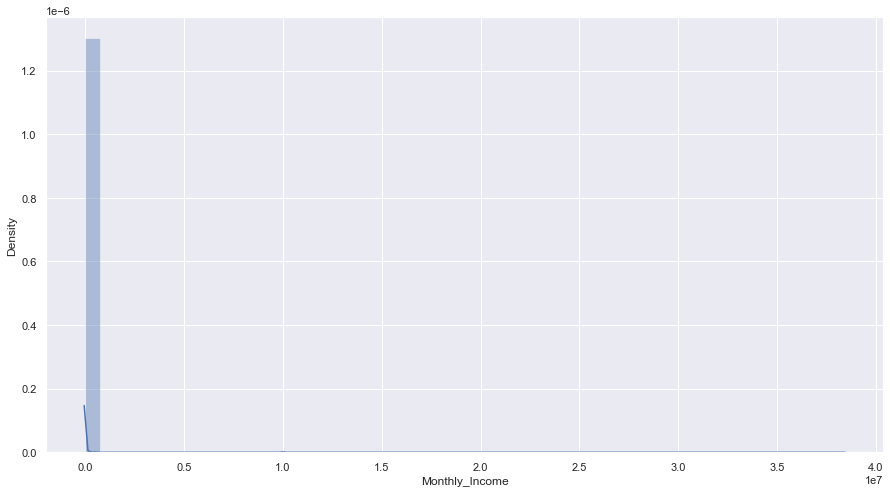

In [108]:
sns.distplot(df2.Monthly_Income)

In [109]:
stats.yeojohnson(df2.Monthly_Income)[0]

array([11.76651627, 13.07350498, 12.03507427, ..., 11.26700768,
       15.71979939, 13.53413412])

<AxesSubplot:ylabel='Density'>

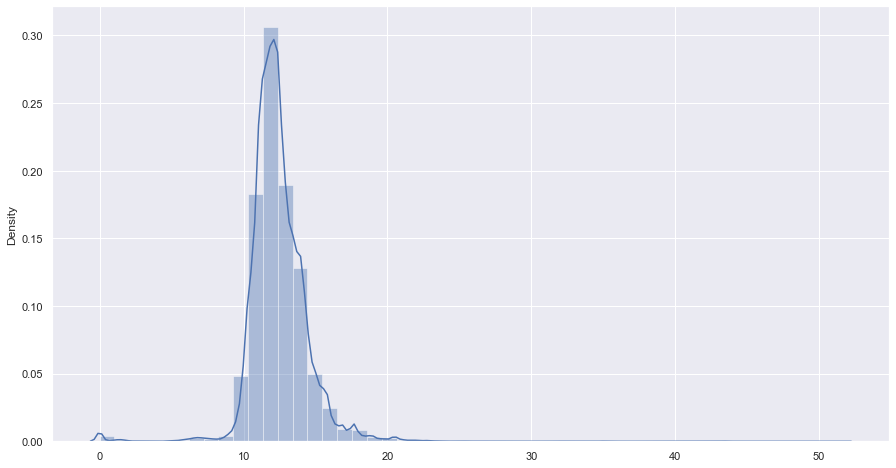

In [110]:
sns.distplot(stats.yeojohnson(df2.Monthly_Income)[0])

In [111]:
pd.DataFrame( stats.yeojohnson(df2.Monthly_Income)[0]).skew()  ##Yeo-Johnson Transformation to reduce highly skewed Monthly Income data.

0    0.529439
dtype: float64

In [112]:
df2['Yeo_Scaled_Income'] = pd.Series(stats.yeojohnson(df2.Monthly_Income)[0])

In [113]:
df2.Yeo_Scaled_Income.skew()

0.5294394901755187

In [114]:
ols('Yeo_Scaled_Income~City_Code', data = df2).fit().summary() ## Now we can categorize city codes basis monthly income.

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:      Yeo_Scaled_Income   R-squared:                       0.038
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     3.955
Date:                Tue, 22 Feb 2022   Prob (F-statistic):          6.13e-229
Time:                        17:29:24   Log-Likelihood:            -1.4467e+05
No. Observations:               68899   AIC:                         2.907e+05
Df Residuals:                   68221   BIC:                         2.969e+05
Df Model:                         677                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept              12.8357      0.020    646.746      0.000      12.797      12.875
City_Code[T.C10002]    -0.0255      0.029     -0.877      0.381      -0.083       0.032
City_Code[T.C10003]    -0.3995      0.029    -13.712      0.000      -0.457      -0.342
City_Code[T.C10004]    -0.2814      0.033     -8.608      0.000      -0.345      -0.217
City_Code[T.C10005]    -0.5177      0.033    -15.594      0.000      -0.583      -0.453
City_Code[T.C10006]    -0.3067      0.036     -8.405      0.000      -0.378      -0.235
City_Code[T.C10007]    -0.8284      0.046    -18.048      0.000      -0.918      -0.738
City_Code[T.C10008]    -0.7673      0.056    -13.755      0.000      -0.877      -0.658
City_Code[T.C10009]    -0.8177      0.064    -12.730      0.000      -0.944      -0.692
City_Code[T.C10010]    -0.1078      0.067     -1.608      0.108      -0.239       0.024
City_Code[T.C10011]    -1.0279      0.068    -15.103      0.000      -1.161      -0.895
City_Code[T.C10012]    -0.7164      0.077     -9.334      0.000      -0.867      -0.566
City_Code[T.C10013]    -0.7983      0.078    -10.188      0.000      -0.952      -0.645
City_Code[T.C10014]    -0.7175      0.081     -8.825      0.000      -0.877      -0.558
City_Code[T.C10015]    -0.5215      0.083     -6.264      0.000      -0.685      -0.358
City_Code[T.C10016]    -0.9729      0.084    -11.585      0.000      -1.137      -0.808
City_Code[T.C10017]    -0.9675      0.092    -10.512      0.000      -1.148      -0.787
City_Code[T.C10018]    -0.8776      0.093     -9.414      0.000      -1.060      -0.695
City_Code[T.C10019]    -0.5367      0.094     -5.739      0.000      -0.720      -0.353
City_Code[T.C10020]    -0.4649      0.096     -4.839      0.000      -0.653      -0.277
City_Code[T.C10021]    -0.8622      0.100     -8.659      0.000      -1.057      -0.667
City_Code[T.C10022]    -0.5288      0.101     -5.211      0.000      -0.728      -0.330
City_Code[T.C10023]    -0.5591      0.108     -5.186      0.000      -0.770      -0.348
City_Code[T.C10024]    -0.5311      0.107     -4.974      0.000      -0.740      -0.322
City_Code[T.C10025]    -0.4302      0.116     -3.698      0.000      -0.658      -0.202
City_Code[T.C10026]    -1.2004      0.117    -10.286      0.000      -1.429      -0.972
City_Code[T.C10027]    -0.0580      0.119     -0.487      0.626      -0.291       0.175
City_Code[T.C10028]    -0.6907      0.126     -5.486      0.000      -0.937      -0.444
City_Code[T.C10029]    -0.9799      0.132     -7.432      0.000      -1.238      -0.721
City_Code[T.C10030]    -0.8162      0.135     -6.032      0.000      -1.081      -0.551
City_Code[T.C10031]    -0.9458      0.139     -6.784      0.000      -1.219      -0.673
City_Code[T.C10032]    -0.9327      0.141     -6.611      0.000      -1.209      -0.656
Cit

In [115]:
anova_lm(ols('Yeo_Scaled_Income~City_Code', data = df2).fit())

,df,sum_sq,mean_sq,F,PR(>F)
City_Code,677.0,10553.897445,15.589213,3.955023,6.134151e-229
Residual,68221.0,268901.510524,3.941624,NaN,NaN


In [116]:
## Checking relationship between city_code and age

In [117]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69713 entries, 0 to 69712
Data columns (total 23 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   69713 non-null  object 
 1   Gender                               69713 non-null  object 
 2   City_Code                            68899 non-null  object 
 3   City_Category                        69713 non-null  object 
 4   Employer_Code                        65695 non-null  object 
 5   Employer_Category1                   69713 non-null  object 
 6   Employer_Category2                   69713 non-null  float64
 7   Monthly_Income                       69713 non-null  float64
 8   Customer_Existing_Primary_Bank_Code  60322 non-null  object 
 9   Primary_Bank_Type                    69713 non-null  object 
 10  Contacted                            69713 non-null  object 
 11  Source                      

In [118]:
anova_lm(ols('Age~City_Code', data = df2).fit())

,df,sum_sq,mean_sq,F,PR(>F)
City_Code,677.0,1.286539e+05,190.035354,3.908889,4.588618e-224
Residual,68221.0,3.316646e+06,48.616204,NaN,NaN


In [119]:
### We may create a new feature basis city code by relating it with monthly income of applicants.

In [120]:
from pandas_profiling import ProfileReport

In [121]:
ProfileReport(df2)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Treating null values of Existing_EMI

In [122]:
df2.loc[:,['Monthly_Income','Yeo_Scaled_Income','Existing_EMI']].corr()

,Monthly_Income,Yeo_Scaled_Income,Existing_EMI
Monthly_Income,1.000000,0.190089,0.245826
Yeo_Scaled_Income,0.190089,1.000000,0.190565
Existing_EMI,0.245826,0.190565,1.000000


In [123]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69713 entries, 0 to 69712
Data columns (total 23 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   69713 non-null  object 
 1   Gender                               69713 non-null  object 
 2   City_Code                            68899 non-null  object 
 3   City_Category                        69713 non-null  object 
 4   Employer_Code                        65695 non-null  object 
 5   Employer_Category1                   69713 non-null  object 
 6   Employer_Category2                   69713 non-null  float64
 7   Monthly_Income                       69713 non-null  float64
 8   Customer_Existing_Primary_Bank_Code  60322 non-null  object 
 9   Primary_Bank_Type                    69713 non-null  object 
 10  Contacted                            69713 non-null  object 
 11  Source                      

In [124]:
df2.loc[df2.Existing_EMI.isna()]

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month,Yeo_Scaled_Income
34454,APPD80118329949,Male,C10020,A,COM0009891,A,4.0,4000.0,NaN,P,Y,S143,B,NaN,10000.0,2.0,17.50,497.0,10,0,32.0,8,13.397212
40760,APPX60980674941,Female,C10006,A,COM0009891,A,4.0,5900.0,NaN,P,N,S122,D,NaN,NaN,NaN,NaN,NaN,10,0,24.0,8,14.366370
47465,APPV80946344329,Female,C10003,A,COM0009891,A,4.0,1850.0,NaN,P,N,S122,G,NaN,NaN,NaN,NaN,NaN,2,0,26.0,4,11.590627
49318,APPD90311083924,Male,C10006,A,COM0009891,A,4.0,3200.0,NaN,P,Y,S122,G,NaN,52000.0,4.0,14.49,1434.0,10,0,31.0,6,12.858868
49488,APPN10562848706,Female,C10006,A,COM0009891,A,4.0,2250.0,NaN,P,N,S122,G,NaN,NaN,NaN,NaN,NaN,2,0,27.0,6,12.035074
54058,APPG20811117815,Female,C10018,C,COM0009891,A,4.0,2124.0,NaN,G,N,S122,G,NaN,NaN,NaN,NaN,NaN,2,0,22.0,9,11.903247
54440,APPR30468632703,Female,C10003,A,COM0009891,A,4.0,4000.0,NaN,P,N,S122,G,NaN,NaN,NaN,NaN,NaN,10,0,44.0,9,13.397212
56036,APPM80237776839,Female,C10004,A,COM0009891,A,4.0,3500.0,NaN,P,N,S122,G,NaN,NaN,NaN,NaN,NaN,10,0,27.0,9,13.073505
56482,APPM90975428414,Male,C10002,A,COM0009891,A,4.0,3000.0,NaN,P,Y,S122,G,NaN,52000.0,4.0,13.99,1421.0,4,0,35.0,9,12.705568
58410,APPO70449244803,Female,C10001,A,COM0009891,A,4.0,8700.0,NaN,P,N,S122,G,NaN,NaN,NaN,NaN,NaN,10,0,34.0,9,15.376238


In [125]:
df2.Existing_EMI.describe()

count     69662.000000
mean        360.928751
std        2288.517927
min           0.000000
25%           0.000000
50%           0.000000
75%         350.000000
max      545436.500000
Name: Existing_EMI, dtype: float64

In [126]:
df2.loc[df2.Existing_EMI.isna(),'Existing_EMI'] = df2.Existing_EMI.fillna(0)    #### Treating null values for Existing EMI

In [127]:
df2.isnull().sum()

ID                                         0
Gender                                     0
City_Code                                814
City_Category                              0
Employer_Code                           4018
Employer_Category1                         0
Employer_Category2                         0
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code     9391
Primary_Bank_Type                          0
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                               0
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
Age                                        0
Lead_Creation_Month                        0
Yeo_Scaled

#### Treating Null Values of CEPB

In [128]:
df2.Customer_Existing_Primary_Bank_Code.nunique()

57

In [129]:
anova_lm(ols('Yeo_Scaled_Income~Customer_Existing_Primary_Bank_Code', data = df2).fit())  ## there's relation.

,df,sum_sq,mean_sq,F,PR(>F)
Customer_Existing_Primary_Bank_Code,56.0,6294.534661,112.402405,32.437847,0.0
Residual,60265.0,208828.005140,3.465162,NaN,NaN


In [130]:
freq = pd.crosstab(df2.Customer_Existing_Primary_Bank_Code,df2.Source_Category)

stats.chi2_contingency(freq)[1]               ## relation exists between cepb and source category

7.731073326141403e-27

In [131]:
freq = pd.crosstab(df2.Customer_Existing_Primary_Bank_Code,df2.Source)

stats.chi2_contingency(freq)[1]               ## more relation to category.

6.045906048563261e-68

In [132]:
freq = pd.crosstab(df2.Customer_Existing_Primary_Bank_Code,df2.Gender)

stats.chi2_contingency(freq)[1]           ## strong relation but weaker to source

1.0685405764515297e-61

In [133]:
### We might like to fill null values of CEPB basis Source.

In [134]:
freq = pd.crosstab(df2.Customer_Existing_Primary_Bank_Code,df2.Source)
freq

Source,S122,S123,S124,S127,S129,S130,S133,S134,S135,S136,S137,S138,S139,S141,S143,S144,S150,S151,S153,S154,S155,S156,S157,S158,S159,S160,S161,S162
Customer_Existing_Primary_Bank_Code,,,,,,,,,,,,,,,,,,,,,,,,,,,,
B001,6088,14,5,331,1,0,5004,243,2,0,353,0,0,11,823,37,0,84,59,1,0,41,103,24,860,1,107,5
B002,4499,19,4,203,0,0,3949,173,0,0,384,1,1,6,674,31,1,51,42,0,0,29,46,26,635,1,98,7
B003,3495,7,2,250,0,1,3608,146,0,3,262,0,0,6,455,50,0,94,70,0,0,76,85,49,726,2,124,4
B004,2860,12,1,171,1,0,2667,106,0,0,123,0,0,4,399,21,0,56,45,0,2,23,48,20,448,0,60,3
B005,825,0,2,31,0,0,759,45,0,0,6,0,0,1,161,0,0,5,2,0,0,1,4,0,68,0,8,2
B006,709,0,0,32,0,0,636,32,0,0,11,0,0,2,103,3,0,12,7,0,0,5,8,2,84,0,14,2
B007,464,0,0,34,0,0,445,18,0,0,45,0,0,0,70,4,3,19,10,0,1,2,9,2,100,0,12,1
B008,350,3,0,27,0,0,357,12,0,0,6,0,0,0,44,6,0,11,11,0,0,7,15,5,78,0,12,1
B009,373,0,0,25,0,0,364,13,0,0,3,0,0,1,28,2,0,16,24,0,0,4,7,3,69,0,9,0


In [135]:
df2.Source.nunique()  ##total unique Source values

29

In [136]:
df2.loc[df2.Customer_Existing_Primary_Bank_Code.isna()].Source.nunique()   ##Unique source values where CEPB is null.

20

#### Impuding null values od CEPB basis Source

In [137]:
df2['Customer_Existing_Primary_Bank_Code'] = df2.groupby('Source')['Customer_Existing_Primary_Bank_Code'].transform(lambda x :x.replace(to_replace = np.nan, value = x.mode))

In [138]:
df2.isnull().sum()

ID                                         0
Gender                                     0
City_Code                                814
City_Category                              0
Employer_Code                           4018
Employer_Category1                         0
Employer_Category2                         0
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code        0
Primary_Bank_Type                          0
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                               0
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
Age                                        0
Lead_Creation_Month                        0
Yeo_Scaled

In [139]:
##We have dealt with most of null values.

### Feature Enginerring

#### 1. City_Code

In [140]:
df2.City_Code.nunique()

678

In [141]:
df2.City_Code.unique()

array(['C10001', 'C10003', 'C10125', 'C10477', 'C10002', 'C10402',
       'C10022', 'C10014', 'C10030', 'C10032', 'C10019', 'C10006',
       'C10016', 'C10004', 'C10051', 'C10024', 'C10005', 'C10097',
       'C10007', 'C10712', 'C10015', 'C10023', 'C10027', 'C10013',
       'C10020', 'C10036', 'C10008', 'C10031', 'C10210', 'C10121',
       'C10162', 'C10017', 'C10010', 'C10028', 'C10011', 'C10009',
       'C10169', 'C10069', 'C10283', 'C10492', 'C10519', 'C10376',
       'C10018', 'C10140', 'C10260', 'C10251', 'C10434', 'C10148',
       'C10039', 'C10021', 'C10221', 'C10268', 'C10167', 'C10112',
       'C10103', 'C10091', 'C10094', 'C10060', 'C10033', 'C10130',
       'C10040', 'C10263', 'C10072', 'C10054', 'C10064', 'C10093',
       'C10042', 'C10314', 'C10487', 'C10449', 'C10025', 'C10107',
       'C10573', 'C10110', 'C10645', 'C10063', 'C10066', 'C10203',
       'C10074', 'C10034', 'C10255', 'C10084', 'C10012', 'C10611',
       'C10333', 'C10073', 'C10340', 'C10044', 'C10229', 'C101

In [142]:
df2.City_Code.describe()

count      68899
unique       678
top       C10001
freq       10007
Name: City_Code, dtype: object

In [143]:
freq = pd.crosstab(df2.Employer_Category1,df2.City_Code)

stats.chi2_contingency(freq)[1]

0.0

In [144]:
df2.Employer_Code.nunique()

36617

In [145]:
freq = pd.crosstab(df2.Employer_Category2,df2.City_Code)

stats.chi2_contingency(freq)[1]

4.564871758824971e-13

In [146]:
df2.groupby('Employer_Category1')['City_Code'].value_counts()

Employer_Category1  City_Code
A                   C10001       5213
                    C10003       4252
                    C10002       3937
                    C10004       2923
                    C10005       2731
                    C10006       1933
                    C10007       1230
                    C10008        779
                    C10009        665
                    C10011        540
                    C10013        449
                    C10010        414
                    C10015        394
                    C10014        390
                    C10016        347
                    C10012        320
                    C10019        302
                    C10018        291
                    C10021        276
                    C10022        259
                    C10017        239
                    C10023        237
                    C10020        202
                    C10026        198
                    C10028        189
                    

In [147]:
df2.groupby('Employer_Category1')['City_Code'].count()

Employer_Category1
A    36720
B    17949
C    14230
Name: City_Code, dtype: int64

In [148]:
df2.groupby('Employer_Category2')['City_Code'].count()

Employer_Category2
1.0     4231
2.0     1945
3.0     1614
4.0    61109
Name: City_Code, dtype: int64

In [149]:
df2.groupby('Employer_Category1')['City_Code'].nunique()      ###Overlapped City Codes basis EC1.

Employer_Category1
A    640
B    354
C    435
Name: City_Code, dtype: int64

In [150]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69713 entries, 0 to 69712
Data columns (total 23 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   69713 non-null  object 
 1   Gender                               69713 non-null  object 
 2   City_Code                            68899 non-null  object 
 3   City_Category                        69713 non-null  object 
 4   Employer_Code                        65695 non-null  object 
 5   Employer_Category1                   69713 non-null  object 
 6   Employer_Category2                   69713 non-null  float64
 7   Monthly_Income                       69713 non-null  float64
 8   Customer_Existing_Primary_Bank_Code  69713 non-null  object 
 9   Primary_Bank_Type                    69713 non-null  object 
 10  Contacted                            69713 non-null  object 
 11  Source                      

In [151]:
df2.Monthly_Income.describe()

count    6.971300e+04
mean     5.622283e+03
std      1.747671e+05
min      0.000000e+00
25%      1.650000e+03
50%      2.500000e+03
75%      4.000000e+03
max      3.838384e+07
Name: Monthly_Income, dtype: float64

<AxesSubplot:xlabel='Monthly_Income'>

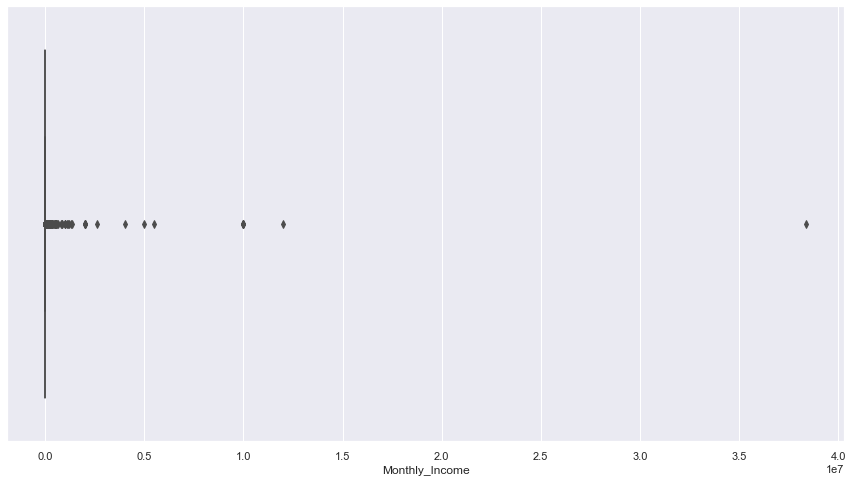

In [152]:
sns.boxplot(df2.Monthly_Income)

<AxesSubplot:xlabel='Yeo_Scaled_Income'>

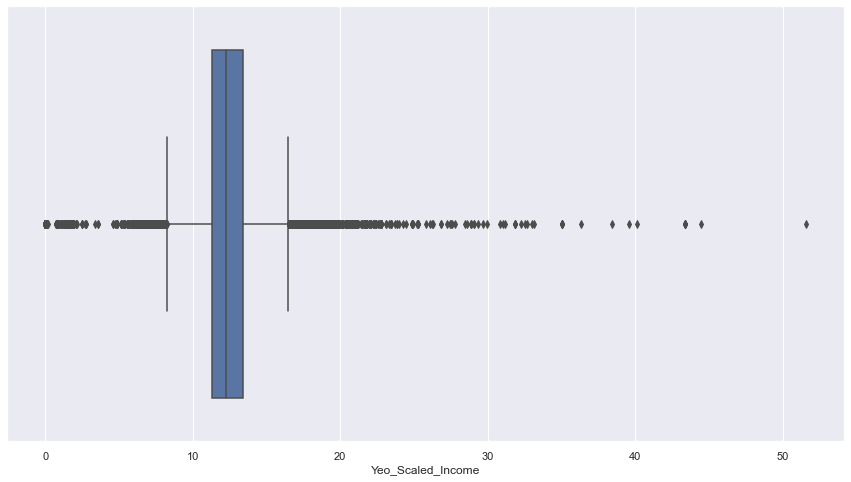

In [153]:
sns.boxplot(df2.Yeo_Scaled_Income)

In [154]:
pd.crosstab(df2.City_Category,df2.Age)

Age,17.0,18.0,19.0,20.0,21.0,22.0,23.0,24.0,25.0,26.0,27.0,28.0,29.0,30.0,31.0,32.0,33.0,34.0,35.0,36.0,37.0,38.0,39.0,40.0,41.0,42.0,43.0,44.0,45.0,46.0,47.0,48.0,49.0,50.0,51.0,52.0,53.0,54.0,55.0,56.0,57.0,58.0,59.0,60.0,61.0,62.0,63.0,64.0,65.0,66.0,67.0,68.0,69.0,70.0,71.0,72.0,73.0,74.0,77.0,78.0,83.0,86.0
City_Category,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
A,1,63,113,260,606,1218,2103,2866,3851,4102,4290,3927,3928,3511,2910,2631,2239,2058,1728,1141,1046,792,656,606,458,387,361,293,541,242,235,177,175,184,157,129,149,101,114,83,62,47,43,34,16,13,11,14,11,0,1,4,3,0,1,2,2,0,1,0,1,1
B,0,15,34,62,130,223,339,414,514,584,611,528,478,487,363,312,289,266,236,182,152,132,107,93,74,78,38,45,101,39,55,53,28,35,34,24,32,25,29,23,18,10,6,6,3,0,4,4,2,1,0,0,0,1,0,0,0,0,0,1,0,0
C,3,31,46,103,149,242,404,550,726,765,827,834,793,720,703,562,513,420,378,312,258,241,200,209,169,136,123,124,133,152,100,75,101,84,76,85,61,56,56,38,33,27,22,13,7,6,8,11,7,0,0,1,0,0,0,0,0,1,0,0,0,0


#### New Feature of Age

In [155]:
def Age_Cat(x) :
    if x <= 25 :
        return('Young')
    elif (x>25) and (x<=40) :
        return('Middle-Aged')
    elif (x>40) and (x<=60) :
        return('Aged')
    else :
        return('Old')
        
        

In [156]:
df2['Age_Cat'] = df2.Age.apply(Age_Cat)

In [157]:
pd.crosstab(df2.City_Category,df2.Age_Cat)

Age_Cat,Aged,Middle-Aged,Old,Young
City_Category,,,,
A,3972,35565,81,11081
B,753,4820,16,1731
C,1664,7735,41,2254


In [158]:
from scipy.stats import ttest_ind

ttest_ind(df2.Age,df2.Monthly_Income)           ## Relation between Age and Income of applicants

Ttest_indResult(statistic=-8.447516040150626, pvalue=3.0037092975343315e-17)

In [159]:
df2.Age_Cat.value_counts()

Middle-Aged    48120
Young          15066
Aged            6389
Old              138
Name: Age_Cat, dtype: int64

<AxesSubplot:xlabel='Age_Cat', ylabel='Monthly_Income'>

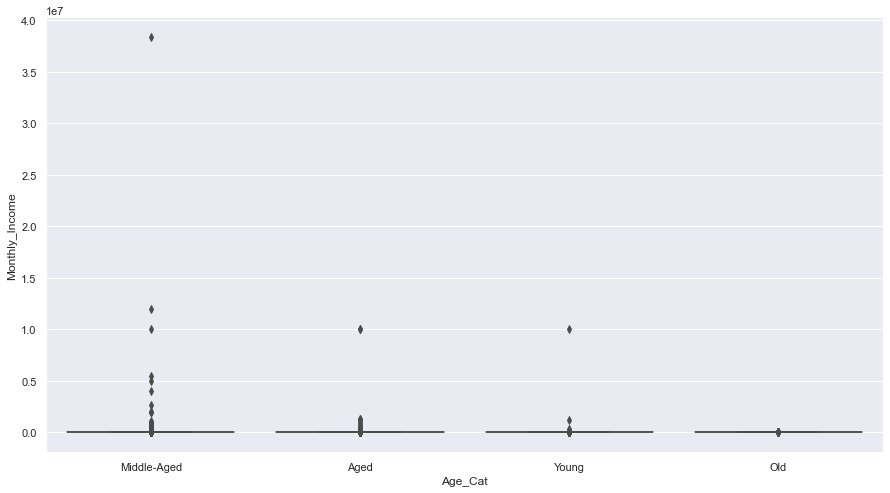

In [160]:
sns.boxplot(x = 'Age_Cat', y = 'Monthly_Income', data = df2)

In [161]:
### Most loans being applied by middle-aged population.

In [162]:
freq = pd.crosstab(df2.Employer_Category1,df2.Age_Cat)

stats.chi2_contingency(freq)[1]     ## EC1 can be related with Age_Cat

1.2251165635044389e-207

In [163]:
freq = pd.crosstab(df2.Employer_Category2,df2.Age_Cat)

stats.chi2_contingency(freq)[1]      ## EC2 can be related with Age_Cat

4.1438017964944525e-68

In [164]:
freq = pd.crosstab(df2.City_Code,df2.Age_Cat)

stats.chi2_contingency(freq)[1]

0.0

In [165]:
freq = pd.crosstab(df2.City_Category,df2.Age_Cat)

stats.chi2_contingency(freq)[1]

1.0902113143772437e-111

In [166]:
freq

Age_Cat,Aged,Middle-Aged,Old,Young
City_Category,,,,
A,3972,35565,81,11081
B,753,4820,16,1731
C,1664,7735,41,2254


In [167]:
A = [3972/81,35565/81,1,11081/81]
B = [753/16,4820/16,1,1731/16]
C = [1664/41,7735/41,1,2254/41]

In [168]:
print(A,B,C)

[49.03703703703704, 439.0740740740741, 1, 136.80246913580248] [47.0625, 301.25, 1, 108.1875] [40.58536585365854, 188.65853658536585, 1, 54.97560975609756]


In [169]:
df2.groupby(['Age_Cat','Employer_Category1'])['Monthly_Income'].median()         ## Obvious Trend of income w.r.t age irrespective of EC.

Age_Cat      Employer_Category1
Aged         A                     3000.0
             B                     3100.0
             C                     3600.0
Middle-Aged  A                     2500.0
             B                     2800.0
             C                     2700.0
Old          A                     2500.0
             B                     3000.0
             C                     3000.0
Young        A                     1800.0
             B                     1889.5
             C                     1800.0
Name: Monthly_Income, dtype: float64

In [170]:
df2.groupby(['Age_Cat','City_Category'])['Monthly_Income'].median()    ## Obvious Trend of income w.r.t age irrespective of EC.

Age_Cat      City_Category
Aged         A                3350.0
             B                3000.0
             C                3000.0
Middle-Aged  A                2750.0
             B                2281.3
             C                2150.0
Old          A                2500.0
             B                2432.3
             C                2500.0
Young        A                1900.0
             B                1600.0
             C                1550.0
Name: Monthly_Income, dtype: float64

In [171]:
## City Category seems to be related with median income of the applicant.

In [172]:
df2.groupby(['Age_Cat','Employer_Category2'])['Monthly_Income'].median() 

Age_Cat      Employer_Category2
Aged         1.0                   4550.00
             2.0                   5000.00
             3.0                   3580.00
             4.0                   3007.70
Middle-Aged  1.0                   3800.00
             2.0                   3350.00
             3.0                   2351.50
             4.0                   2500.00
Old          1.0                   3112.25
             4.0                   2500.00
Young        1.0                   2300.00
             2.0                   2100.00
             3.0                   1710.00
             4.0                   1800.00
Name: Monthly_Income, dtype: float64

In [173]:
## We can infer that EC2 has been categorized in a way that cat 1 and 4 are related to buisnesses where as 2 & 3 may be related to conventional workforce.

In [174]:
df2.groupby(['Employer_Category1','Employer_Category2'])['Monthly_Income'].median() 

Employer_Category1  Employer_Category2
A                   1.0                   3400.0
                    2.0                   2503.3
                    3.0                   3000.0
                    4.0                   2400.0
B                   1.0                   3500.0
                    2.0                   3500.0
                    3.0                   2000.0
                    4.0                   2500.0
C                   1.0                   3000.0
                    2.0                   2500.0
                    3.0                   2000.0
                    4.0                   2500.0
Name: Monthly_Income, dtype: float64

In [175]:
df2.Employer_Category1.value_counts()

A    37354
B    18056
C    14303
Name: Employer_Category1, dtype: int64

In [176]:
df2.City_Category.value_counts()

A    50699
C    11694
B     7320
Name: City_Category, dtype: int64

In [177]:
df2.groupby('Employer_Category1')['Employer_Code'].nunique()
## Employer Codes are exhaustive in nature.

Employer_Category1
A    22447
B     8629
C     5541
Name: Employer_Code, dtype: int64

In [178]:
df2.groupby('Employer_Code')['ID'].nunique()     ### Maximum apllicants are from Company encoded as COM0000002.

Employer_Code
COM0000002    457
COM0000003    324
COM0000004    262
COM0000005    243
COM0000006    195
COM0000007    189
COM0000008    121
COM0000009    153
COM0000010    145
COM0000011    131
COM0000012    132
COM0000013    133
COM0000014    126
COM0000015    118
COM0000016     93
COM0000017    115
COM0000018    107
COM0000019    102
COM0000020     94
COM0000021    107
COM0000022     87
COM0000023     95
COM0000024     98
COM0000025     80
COM0000026     77
COM0000027     79
COM0000028     91
COM0000029     73
COM0000030     77
COM0000031     80
COM0000032     74
COM0000033     75
COM0000034     67
COM0000035     67
COM0000036     59
COM0000037     64
COM0000038     62
COM0000039     61
COM0000040     64
COM0000041     63
COM0000042     59
COM0000043     52
COM0000044     58
COM0000045     49
COM0000046     51
COM0000047     50
COM0000048     46
COM0000049     59
COM0000050     59
COM0000051     38
COM0000052     44
COM0000053     55
COM0000054     46
COM0000055     45
COM0000056    

In [179]:
df2.groupby(['Employer_Code','Employer_Category1','Employer_Category2'])['ID'].nunique().sort_values(ascending = True)    

Employer_Code  Employer_Category1  Employer_Category2
COM0024329     A                   4.0                     1
COM0035274     B                   4.0                     1
COM0035272     A                   4.0                     1
COM0035271     A                   4.0                     1
COM0035270     B                   4.0                     1
COM0035269     A                   4.0                     1
COM0035268     A                   4.0                     1
COM0035266     C                   4.0                     1
COM0035264     B                   4.0                     1
COM0035261     B                   4.0                     1
COM0035259     A                   4.0                     1
COM0035255     A                   4.0                     1
COM0035251     A                   4.0                     1
COM0035250     A                   4.0                     1
COM0035249     B                   4.0                     1
COM0035247     A               

In [180]:
## Hypothesis - EC2 cat 4 may relate to small buisness. ## Need strong evidence from Income data// Checking for the same.

In [181]:
df2.groupby('Employer_Code')['ID'].nunique().sort_values()

Employer_Code
COM0024329      1
COM0035274      1
COM0035272      1
COM0035271      1
COM0035270      1
COM0035269      1
COM0035268      1
COM0035266      1
COM0035264      1
COM0035261      1
COM0035259      1
COM0035255      1
COM0035251      1
COM0035250      1
COM0035249      1
COM0035247      1
COM0035246      1
COM0035245      1
COM0035217      1
COM0035221      1
COM0035224      1
COM0035225      1
COM0035226      1
COM0035229      1
COM0035275      1
COM0035230      1
COM0035234      1
COM0035236      1
COM0035238      1
COM0035239      1
COM0035240      1
COM0035243      1
COM0035232      1
COM0035276      1
COM0035277      1
COM0035279      1
COM0035309      1
COM0035311      1
COM0035312      1
COM0035314      1
COM0035315      1
COM0035316      1
COM0035308      1
COM0035317      1
COM0035322      1
COM0035324      1
COM0035325      1
COM0035326      1
COM0035327      1
COM0035330      1
COM0035321      1
COM0035215      1
COM0035307      1
COM0035304      1
COM0035281    

In [182]:
df2.groupby(['Employer_Category2'])['Monthly_Income'].sum().sort_values(ascending = False)

Employer_Category2
4.0    356760158.8
1.0     20981327.1
2.0      9193831.1
3.0      5010911.7
Name: Monthly_Income, dtype: float64

In [183]:
df2.groupby(['Employer_Category2'])['Yeo_Scaled_Income'].median().sort_values(ascending = False)

Employer_Category2
1.0    12.858868
2.0    12.705568
4.0    12.259587
3.0    11.877348
Name: Yeo_Scaled_Income, dtype: float64

In [184]:
df2.groupby(['Employer_Category2'])['Yeo_Scaled_Income'].sum().sort_values(ascending = False)

Employer_Category2
4.0    765901.881656
1.0     55794.661767
2.0     25218.841126
3.0     19716.645256
Name: Yeo_Scaled_Income, dtype: float64

In [185]:
df2.groupby(['Employer_Code','Employer_Category1'])['ID'].nunique().sort_values(ascending = False)    

Employer_Code  Employer_Category1
COM0000002     C                     457
COM0000003     B                     324
COM0000004     B                     262
COM0000005     A                     243
COM0000006     C                     195
COM0000007     C                     189
COM0000009     A                     153
COM0000010     A                     145
COM0000013     A                     133
COM0000012     A                     132
COM0000011     A                     131
COM0000014     A                     126
COM0000008     A                     121
COM0000015     C                     118
COM0000017     C                     115
COM0000018     A                     107
COM0000021     A                     107
COM0000019     A                     102
COM0000024     C                      98
COM0000023     A                      95
COM0000020     A                      94
COM0000016     A                      93
COM0000028     B                      91
COM0000022     B       

In [186]:
### EC1 categorization isn't very clear as in, it seems to have no relation with either population or income.

In [187]:
df_emp = pd.DataFrame(df2.Employer_Code.value_counts())

In [188]:
df_emp.describe()

,Employer_Code
count,36617.000000
mean,1.794112
std,5.419346
min,1.000000
25%,1.000000
50%,1.000000
75%,1.000000
max,457.000000


In [189]:
df2.Employer_Code.value_counts()        ## 36617 Employer Codes needs to be categorized as per Buisness Scale applicants for Loan.

COM0000002    457
COM0000003    324
COM0000004    262
COM0000005    243
COM0000006    195
COM0000007    189
COM0000009    153
COM0000010    145
COM0000013    133
COM0000012    132
COM0000011    131
COM0000014    126
COM0000008    121
COM0000015    118
COM0000017    115
COM0000021    107
COM0000018    107
COM0000019    102
COM0000024     98
COM0000023     95
COM0000020     94
COM0000016     93
COM0000028     91
COM0000022     87
COM0000031     80
COM0000025     80
COM0000027     79
COM0000030     77
COM0000026     77
COM0000033     75
COM0000032     74
COM0000029     73
COM0000034     67
COM0000035     67
COM0000037     64
COM0000040     64
COM0000041     63
COM0000038     62
COM0000039     61
COM0000049     59
COM0000050     59
COM0000036     59
COM0000042     59
COM0000044     58
COM0000053     55
COM0000043     52
COM0000046     51
COM0000061     51
COM0009891     51
COM0000047     50
COM0000045     49
COM0000058     49
COM0000057     47
COM0000062     47
COM0000059     46
COM0000048

#### Categorizing Employer_Code -

* 1.Very Small Scale Family Buisness (VSF) - 1 to 5
* 2.Moderately Small Scale Family & Friends Business(MSF) - 5 to 10
* 3.Micro Small and Medium Enterprises(MSME) - 10 to 50
* 4.Medium Private Enterprises(PVT) - 50 to 100
* 5.Medium to Big Corporates(CP) - 100 to 500



In [190]:
def EC(x) :
    if x <=5 :
        return('VSF')
    elif (x>5) and (x<=10) :
        return('MSF')
    elif (x>10) and (x<=50) :
        return('MSME')
    elif (x>50) and (x<=100) :
        return('PVT')
    elif (x>100) and (x<=500) :
        return('CP')
    else :
        return('Missing')

In [191]:
x = df2.Employer_Code.value_counts()

In [192]:
df2['EC3'] = df2.Employer_Code.map(x)

In [193]:
df2['Employer_Cat3'] = df2.EC3.apply(EC)

In [194]:
df2.drop('EC3',axis = 1, inplace = True)

In [195]:
df2.head()

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month,Yeo_Scaled_Income,Age_Cat,Employer_Cat3
0,APPC90493171225,Female,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,37.0,7,11.766516,Middle-Aged,VSF
1,APPD40611263344,Male,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,30.0,4,13.073505,Middle-Aged,CP
2,APPE70289249423,Male,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,34.0,7,12.035074,Middle-Aged,VSF
3,APPF80273865537,Male,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,27.0,9,13.073505,Middle-Aged,VSF
4,APPG60994436641,Male,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,31.0,7,15.748777,Middle-Aged,VSF


<AxesSubplot:xlabel='Employer_Cat3', ylabel='Yeo_Scaled_Income'>

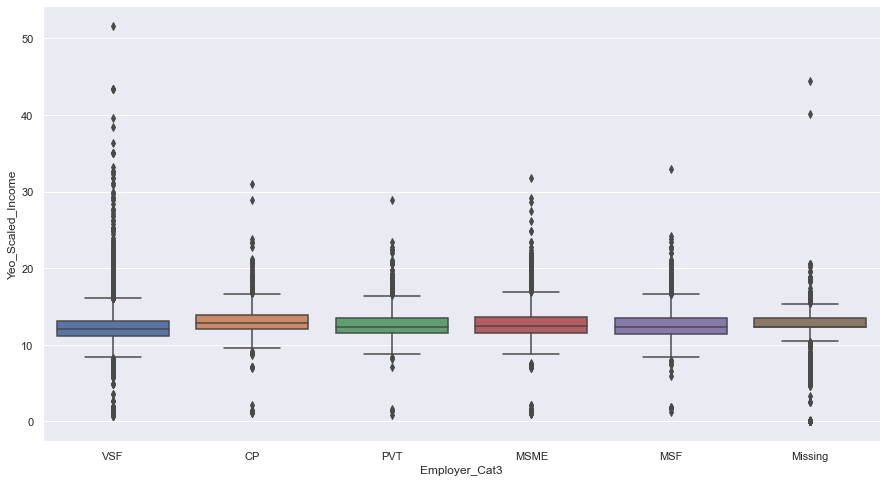

In [196]:
sns.boxplot(x = 'Employer_Cat3', y = 'Yeo_Scaled_Income',data = df2)

In [197]:
sorted(df2.Monthly_Income.unique())

[0.0,
 0.1,
 0.2,
 1.0,
 1.2,
 1.3,
 1.4,
 1.5,
 1.7,
 1.8,
 2.0,
 2.1,
 2.2,
 2.3,
 2.4,
 2.5,
 2.6,
 2.7,
 2.8,
 2.9,
 3.0,
 3.2,
 3.3,
 3.5,
 3.6,
 3.8,
 4.0,
 4.2,
 4.3,
 4.5,
 4.8,
 5.0,
 5.6,
 5.7,
 6.0,
 8.3,
 9.4,
 10.0,
 16.7,
 20.0,
 41.7,
 44.2,
 45.8,
 50.0,
 58.3,
 62.5,
 65.0,
 66.7,
 70.0,
 75.0,
 77.5,
 80.8,
 81.7,
 83.3,
 84.0,
 90.0,
 91.7,
 95.8,
 100.0,
 102.9,
 104.2,
 106.4,
 108.3,
 110.0,
 116.7,
 117.0,
 120.0,
 120.8,
 125.0,
 125.4,
 126.0,
 127.5,
 129.2,
 130.0,
 133.3,
 137.5,
 139.2,
 140.0,
 141.7,
 145.2,
 145.8,
 148.3,
 150.0,
 152.8,
 154.2,
 156.7,
 158.3,
 160.0,
 161.5,
 162.0,
 164.8,
 166.7,
 170.0,
 175.0,
 176.6,
 180.0,
 183.3,
 185.0,
 187.5,
 190.0,
 191.7,
 195.8,
 200.0,
 201.7,
 208.3,
 209.9,
 210.0,
 212.5,
 213.8,
 214.4,
 215.0,
 216.7,
 220.0,
 220.8,
 225.0,
 230.0,
 233.3,
 237.5,
 240.0,
 245.8,
 250.0,
 254.2,
 258.3,
 260.0,
 265.0,
 266.7,
 270.0,
 275.0,
 280.0,
 283.3,
 290.0,
 291.7,
 300.0,
 308.3,
 309.2,
 316.7,
 320.0,

In [198]:
sorted(df2.Yeo_Scaled_Income.unique())

[0.0,
 0.0958008400018519,
 0.18412265648516193,
 0.7196649280472001,
 0.8228881827735991,
 0.8713939137175926,
 0.9180529575352692,
 0.9630083301057358,
 1.0483011931208666,
 1.088852542942424,
 1.1662199716150015,
 1.2031918635147387,
 1.2391144227921949,
 1.2740488651623596,
 1.3080511107768664,
 1.3411723828529833,
 1.3734597236402628,
 1.4049564410960669,
 1.4357024971786487,
 1.4657348467098101,
 1.495087734194159,
 1.551880084067934,
 1.5793766822517414,
 1.6326995103927522,
 1.6585723104977739,
 1.70884638288784,
 1.7572847877501752,
 1.804024095766906,
 1.8267951197312275,
 1.8712097518763071,
 1.9352013378829522,
 1.97624077012439,
 2.0924239825606237,
 2.110864302214263,
 2.1647480661968133,
 2.520475814940308,
 2.663460397547357,
 2.735851433935001,
 3.367661738582845,
 3.6027579892595005,
 4.626295608413516,
 4.711793892078014,
 4.764323964426389,
 4.894951075979328,
 5.127073619942509,
 5.233667989797299,
 5.294165835673965,
 5.3341468402196055,
 5.409264097111835,
 5.517

In [199]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69713 entries, 0 to 69712
Data columns (total 25 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   69713 non-null  object 
 1   Gender                               69713 non-null  object 
 2   City_Code                            68899 non-null  object 
 3   City_Category                        69713 non-null  object 
 4   Employer_Code                        65695 non-null  object 
 5   Employer_Category1                   69713 non-null  object 
 6   Employer_Category2                   69713 non-null  float64
 7   Monthly_Income                       69713 non-null  float64
 8   Customer_Existing_Primary_Bank_Code  69713 non-null  object 
 9   Primary_Bank_Type                    69713 non-null  object 
 10  Contacted                            69713 non-null  object 
 11  Source                      

In [200]:
df2.head()

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month,Yeo_Scaled_Income,Age_Cat,Employer_Cat3
0,APPC90493171225,Female,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,37.0,7,11.766516,Middle-Aged,VSF
1,APPD40611263344,Male,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,30.0,4,13.073505,Middle-Aged,CP
2,APPE70289249423,Male,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,34.0,7,12.035074,Middle-Aged,VSF
3,APPF80273865537,Male,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,27.0,9,13.073505,Middle-Aged,VSF
4,APPG60994436641,Male,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,31.0,7,15.748777,Middle-Aged,VSF


In [201]:
df2.Employer_Cat3.unique()

array(['VSF', 'CP', 'PVT', 'MSME', 'MSF', 'Missing'], dtype=object)

In [202]:
df2.isnull().sum()

ID                                         0
Gender                                     0
City_Code                                814
City_Category                              0
Employer_Code                           4018
Employer_Category1                         0
Employer_Category2                         0
Monthly_Income                             0
Customer_Existing_Primary_Bank_Code        0
Primary_Bank_Type                          0
Contacted                                  0
Source                                     0
Source_Category                            0
Existing_EMI                               0
Loan_Amount                            27709
Loan_Period                            27709
Interest_Rate                          47437
EMI                                    47437
Var1                                       0
Approved                                   0
Age                                        0
Lead_Creation_Month                        0
Yeo_Scaled

In [203]:
df2.head()

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month,Yeo_Scaled_Income,Age_Cat,Employer_Cat3
0,APPC90493171225,Female,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,37.0,7,11.766516,Middle-Aged,VSF
1,APPD40611263344,Male,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,30.0,4,13.073505,Middle-Aged,CP
2,APPE70289249423,Male,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,34.0,7,12.035074,Middle-Aged,VSF
3,APPF80273865537,Male,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,27.0,9,13.073505,Middle-Aged,VSF
4,APPG60994436641,Male,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,31.0,7,15.748777,Middle-Aged,VSF


In [204]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69713 entries, 0 to 69712
Data columns (total 25 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   69713 non-null  object 
 1   Gender                               69713 non-null  object 
 2   City_Code                            68899 non-null  object 
 3   City_Category                        69713 non-null  object 
 4   Employer_Code                        65695 non-null  object 
 5   Employer_Category1                   69713 non-null  object 
 6   Employer_Category2                   69713 non-null  float64
 7   Monthly_Income                       69713 non-null  float64
 8   Customer_Existing_Primary_Bank_Code  69713 non-null  object 
 9   Primary_Bank_Type                    69713 non-null  object 
 10  Contacted                            69713 non-null  object 
 11  Source                      

#### Treating Source and Bank type

In [205]:
df2.Source.mode()

0    S122
dtype: object

In [206]:
df2.Source.nunique()

29

In [207]:
df2.Source_Category.nunique()

7

In [208]:
df2.Source_Category.unique()

array(['G', 'B', 'C', 'E', 'F', 'D', 'A'], dtype=object)

In [209]:
df2.Source.value_counts()

S122    30941
S133    23877
S159     4474
S143     3480
S127     1546
S137     1400
S134     1048
S161      621
S151      569
S157      507
S153      403
S156      250
S144      243
S158      167
S123       61
S141       46
S162       31
S124       17
S150        7
S160        7
S129        3
S155        3
S136        3
S135        2
S139        2
S138        2
S154        1
S130        1
S140        1
Name: Source, dtype: int64

In [210]:
df2.Source_Category.value_counts()

B    29812
G    26518
C    11374
E     1050
D      497
F      459
A        3
Name: Source_Category, dtype: int64

In [211]:
df2.loc[df2.Approved==1,['Source','Source_Category']].Source_Category.value_counts()  ## Most leads are converted from Source Category B,G and C.

B    495
G    364
C    140
E     15
F      6
Name: Source_Category, dtype: int64

In [212]:
df2.loc[df2.Approved==1,['Source','Source_Category']].Source.value_counts()  ## Most leads are coming from S122 and S133.

S122    463
S133    390
S143     72
S134     39
S159     31
S127     12
S151      3
S157      3
S161      2
S141      1
S137      1
S144      1
S158      1
S153      1
Name: Source, dtype: int64

In [213]:
df2.Source.value_counts()        ### Maimum applicants have come from S122 followed S133 belonging to category B and C.

S122    30941
S133    23877
S159     4474
S143     3480
S127     1546
S137     1400
S134     1048
S161      621
S151      569
S157      507
S153      403
S156      250
S144      243
S158      167
S123       61
S141       46
S162       31
S124       17
S150        7
S160        7
S129        3
S155        3
S136        3
S135        2
S139        2
S138        2
S154        1
S130        1
S140        1
Name: Source, dtype: int64

In [214]:
df2.loc[(df2.Approved==1) & (df2.Source=='S133'),['Source','Source_Category']]  ## Source Category isn't exhaustive over Source.

,Source,Source_Category
285,S133,B
357,S133,B
406,S133,B
479,S133,B
676,S133,C
696,S133,B
808,S133,B
859,S133,C
1137,S133,C
1166,S133,B


In [215]:
df2.loc[(df2.Approved==1) & (df2.Source_Category=='B'),['Source','Source_Category']].Source.unique()

array(['S143', 'S133', 'S134', 'S122', 'S159', 'S151', 'S144', 'S127',
       'S157', 'S153', 'S161', 'S137', 'S158'], dtype=object)

In [216]:
df2.loc[(df2.Approved==1) & (df2.Source_Category=='C'),['Source','Source_Category']].Source.unique()

array(['S133', 'S159', 'S127', 'S134', 'S143', 'S122', 'S151', 'S141'],
      dtype=object)

In [217]:
anova_lm(ols('Monthly_Income~Source', data = df2).fit())   ## No Relation.

,df,sum_sq,mean_sq,F,PR(>F)
Source,28.0,1.210287e+12,4.322455e+10,1.415415,0.071342
Residual,69684.0,2.128040e+15,3.053843e+10,NaN,NaN


In [218]:
anova_lm(ols('Monthly_Income~Source_Category', data = df2).fit())   ## No Relation.

,df,sum_sq,mean_sq,F,PR(>F)
Source_Category,6.0,6.000159e+10,1.000027e+10,0.327391,0.922946
Residual,69706.0,2.129190e+15,3.054529e+10,NaN,NaN


In [219]:
ttest_ind(df2.Var1,df2.Approved)    ## Var1 may be related as Credit Score of Applicant.

Ttest_indResult(statistic=271.8205242225609, pvalue=0.0)

In [220]:
anova_lm(ols('Var1~Source_Category', data = df2).fit())

,df,sum_sq,mean_sq,F,PR(>F)
Source_Category,6.0,32872.959321,5478.826553,388.127307,0.0
Residual,69706.0,983973.754779,14.116055,NaN,NaN


In [221]:
anova_lm(ols('Var1~Source', data = df2).fit())

,df,sum_sq,mean_sq,F,PR(>F)
Source,28.0,45528.024258,1626.000866,116.651976,0.0
Residual,69684.0,971318.689841,13.938905,NaN,NaN


In [222]:
ttest_ind(df2.Var1,df2.Monthly_Income)            ## Var1 is having some relation with client's income.

Ttest_indResult(statistic=-8.487991051562533, pvalue=2.1225944379449128e-17)

In [223]:
anova_lm(ols('Lead_Creation_Month~Source', data = df2).fit())     ### We may categorize basis it's lead creation month

,df,sum_sq,mean_sq,F,PR(>F)
Source,28.0,7415.680551,264.845734,47.406463,1.854472e-259
Residual,69684.0,389303.674748,5.586701,NaN,NaN


In [224]:
df2.groupby('Lead_Creation_Month')['Source'].nunique()

Lead_Creation_Month
1     17
2     18
3     17
4     14
5     16
6     15
7     22
8     23
9     14
10    17
11    14
12    17
Name: Source, dtype: int64

In [225]:
df2.groupby('Lead_Creation_Month')['Source_Category'].nunique()

Lead_Creation_Month
1     6
2     6
3     7
4     6
5     6
6     6
7     6
8     7
9     6
10    7
11    6
12    6
Name: Source_Category, dtype: int64

In [226]:
df2.groupby('Lead_Creation_Month')['Approved'].value_counts()

Lead_Creation_Month  Approved
1                    0            1967
                     1              27
2                    0            3173
                     1              27
3                    0            1965
                     1              38
4                    0            2255
                     1              43
5                    0            2435
                     1              41
6                    0            2188
                     1              32
7                    0           15251
                     1             215
8                    0           15653
                     1             266
9                    0           18214
                     1             232
10                   0            1581
                     1              35
11                   0            1778
                     1              22
12                   0            2233
                     1              42
Name: Approved, dtype: int64

In [227]:
df2.loc[df2.Source=='S151',['Source_Category','Employer_Cat3']].Source_Category.nunique()

2

In [228]:
df2.groupby('Source')['Monthly_Income'].median().sort_values()

Source
S138     1229.5
S154     1500.0
S140     1500.0
S153     1700.0
S159     1850.0
S139     1850.0
S160     1960.0
S141     2000.0
S157     2000.0
S144     2000.0
S127     2100.0
S151     2100.0
S161     2300.0
S133     2400.0
S162     2499.2
S134     2500.0
S130     2500.0
S122     2500.0
S143     2865.0
S156     3300.0
S129     3500.0
S124     3500.0
S158     4000.0
S123     4000.0
S137     5000.0
S150     5900.0
S136    10000.0
S155    12000.0
S135    20700.0
Name: Monthly_Income, dtype: float64

In [229]:
df2.City_Code.nunique()

678

In [230]:
pd.crosstab(df2['Source'], df2['Employer_Cat3'])

Employer_Cat3,CP,MSF,MSME,Missing,PVT,VSF
Source,,,,,,
S122,1583,2231,3885,3787,1011,18444
S123,0,5,10,1,0,45
S124,1,0,1,0,1,14
S127,43,102,205,11,42,1143
S129,0,0,0,0,0,3
S130,0,0,1,0,0,0
S133,1039,1860,3347,149,768,16714
S134,42,88,168,5,30,715
S135,1,0,1,0,0,0


#### We can conclude that both the Sources and Source Categories are exhaustive and can't be engineered to any further new feature

### Outliers and its Treatment

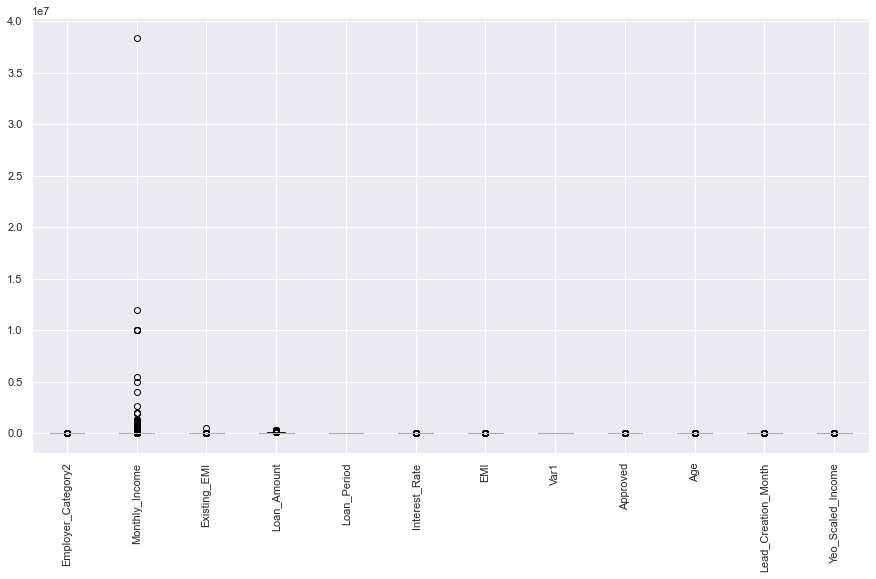

In [231]:
df2.boxplot()
plt.xticks(rotation=90)
plt.show()

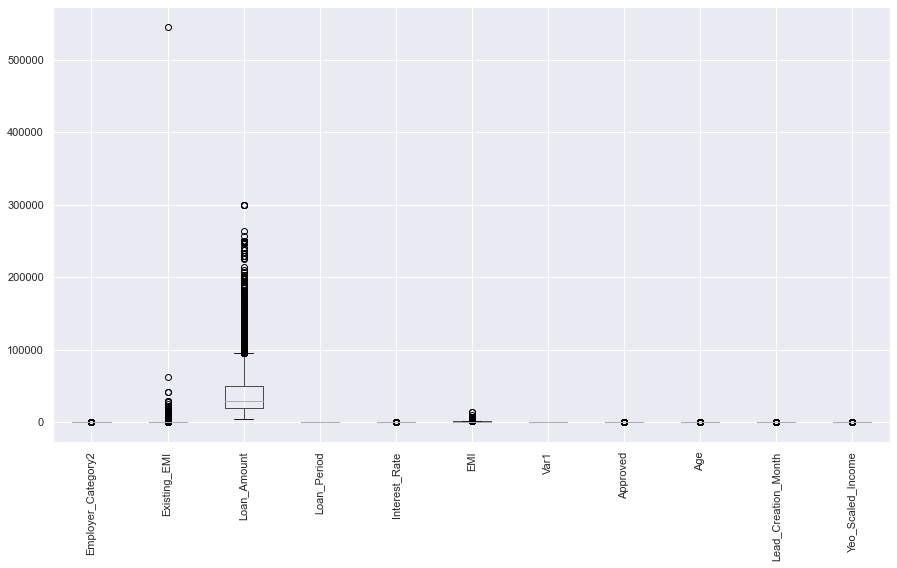

In [232]:
df2.drop('Monthly_Income', axis = 1).boxplot()
plt.xticks(rotation=90)
plt.show()

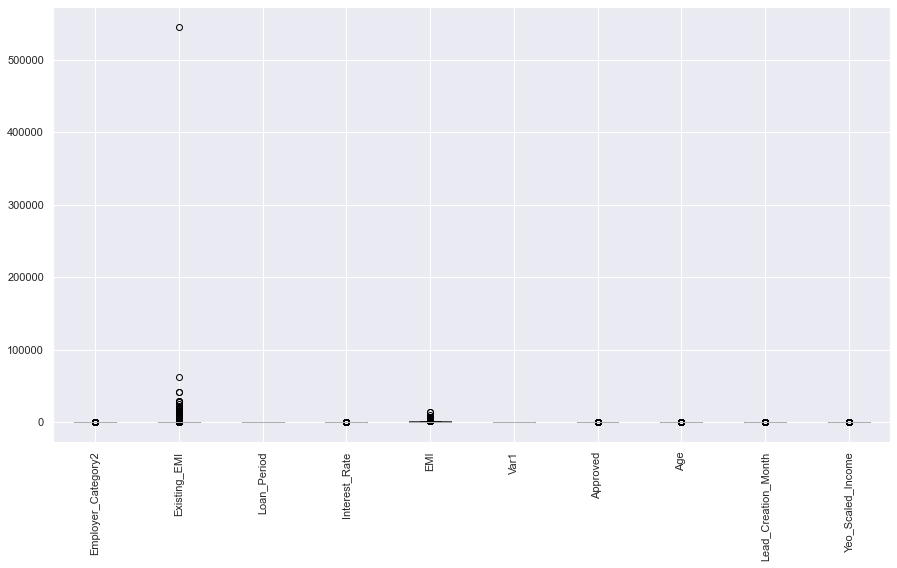

In [233]:
df2.drop(['Monthly_Income','Loan_Amount'], axis = 1).boxplot()
plt.xticks(rotation=90)
plt.show()

In [234]:
num = df2.select_dtypes(include = np.number).columns
num

Index(['Employer_Category2', 'Monthly_Income', 'Existing_EMI', 'Loan_Amount',
       'Loan_Period', 'Interest_Rate', 'EMI', 'Var1', 'Approved', 'Age',
       'Lead_Creation_Month', 'Yeo_Scaled_Income'],
      dtype='object')

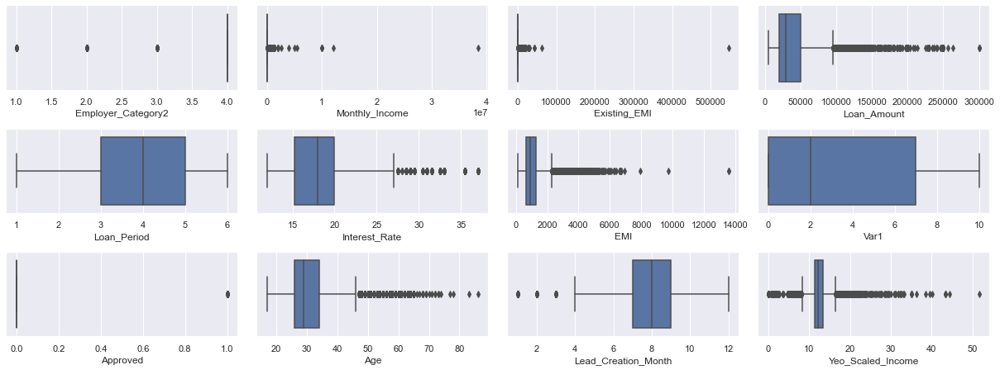

In [235]:
num = df2.select_dtypes(include = np.number).columns
a = 4
b = 4
c = 1

plt.figure(figsize = [17,8])
for i in num :
    
    plt.subplot(a,b,c)
    sns.boxplot(df2[i])
    c+=1
plt.tight_layout()
plt.show()
    
    

In [236]:
##Outlier Treatment may lead to loss of buisness perspective.
## LL of Yeo-Scaled Income might be problamatic.

#### Checking Income w.r.t age categories

In [237]:
df2.Age_Cat.unique()

array(['Middle-Aged', 'Aged', 'Young', 'Old'], dtype=object)

(0.0, 1000000.0)

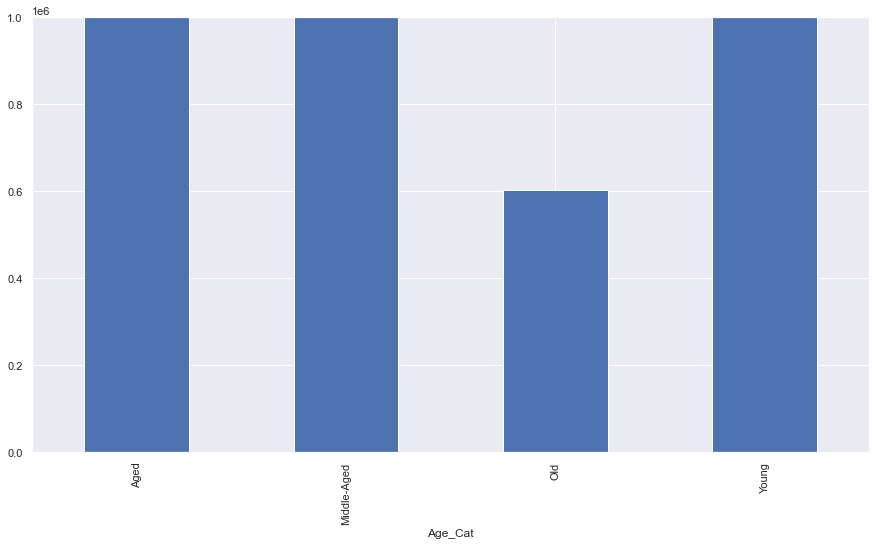

In [238]:
df2.groupby('Age_Cat')['Monthly_Income'].sum().plot(kind='bar')
plt.ylim(0, 1000000)

    

In [239]:
df2.loc[df2.Monthly_Income<=5,['Monthly_Income','Age_Cat']].Age_Cat.unique()

array(['Middle-Aged', 'Young', 'Aged', 'Old'], dtype=object)

In [240]:
df2.loc[df2.Monthly_Income>5,['Monthly_Income','Age_Cat']].Age_Cat.unique()

array(['Middle-Aged', 'Aged', 'Young', 'Old'], dtype=object)

<AxesSubplot:xlabel='Age_Cat'>

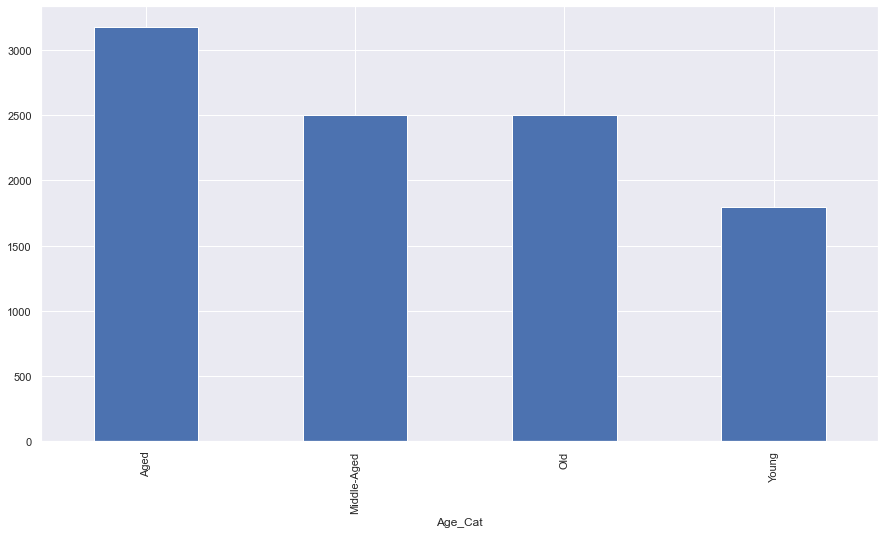

In [241]:
df2.groupby('Age_Cat')['Monthly_Income'].median().plot(kind='bar')


In [242]:
df2.groupby('Age_Cat')['Monthly_Income'].sum()

Age_Cat
Aged            59226491.9
Middle-Aged    282084512.0
Old               602908.9
Young           50032315.9
Name: Monthly_Income, dtype: float64

In [243]:
pd.crosstab(df2.Age_Cat,df2.Employer_Cat3)

Employer_Cat3,CP,MSF,MSME,Missing,PVT,VSF
Age_Cat,,,,,,
Aged,118,366,576,669,97,4563
Middle-Aged,2286,3628,6540,2531,1478,31657
Old,0,3,5,47,0,83
Young,756,1109,2050,771,600,9780


(0.0, 1000.0)

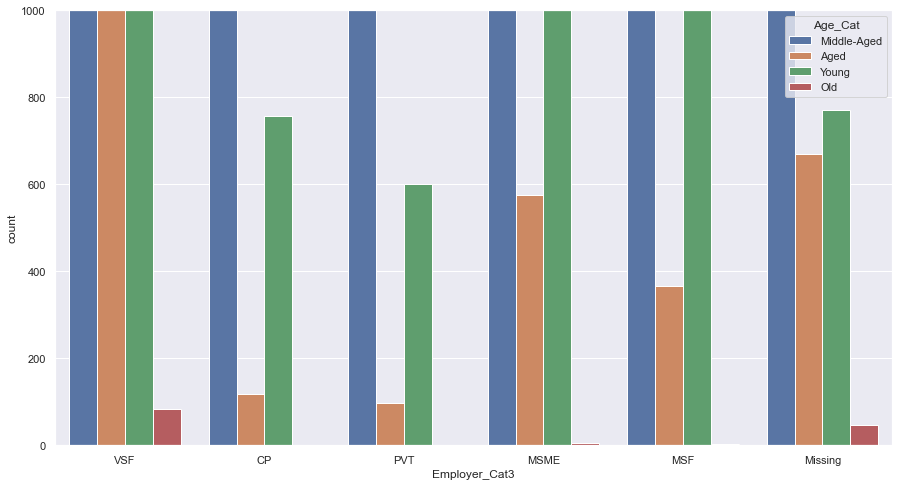

In [244]:
sns.countplot(df2.Employer_Cat3, hue = df2['Age_Cat'])
plt.ylim(0, 1000)

(0.0, 100000.0)

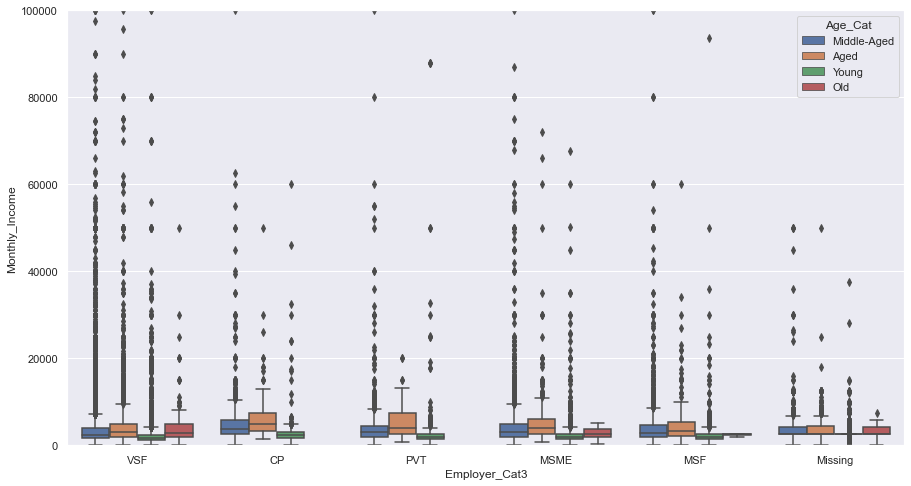

In [245]:
sns.boxplot(y = df2.Monthly_Income,x = df2.Employer_Cat3, hue = df2.Age_Cat)
plt.ylim(0,100000)

In [246]:
### Old People are having on an average less income across Employer Categories.

In [247]:
df2.Age_Cat.value_counts()

Middle-Aged    48120
Young          15066
Aged            6389
Old              138
Name: Age_Cat, dtype: int64

In [248]:
df2.loc[df2['Monthly_Income']<3, 'Age_Cat'].value_counts()/df2['Age_Cat'].value_counts()


Aged           0.010330
Middle-Aged    0.004032
Old            0.079710
Young          0.002788
Name: Age_Cat, dtype: float64

### Pattern RnD

In [249]:
df2.groupby(['Approved', 'Employer_Cat3'])['Age_Cat'].value_counts()

Approved  Employer_Cat3  Age_Cat    
0         CP             Middle-Aged     2231
                         Young            749
                         Aged             110
          MSF            Middle-Aged     3532
                         Young           1104
                         Aged             354
                         Old                3
          MSME           Middle-Aged     6376
                         Young           2035
                         Aged             560
                         Old                5
          Missing        Middle-Aged     2529
                         Young            770
                         Aged             667
                         Old               47
          PVT            Middle-Aged     1437
                         Young            595
                         Aged              96
          VSF            Middle-Aged    31184
                         Young           9741
                         Aged            44

In [250]:
df2.groupby(['Approved'])['Employer_Cat3'].value_counts()

Approved  Employer_Cat3
0         VSF              45493
          MSME              8976
          MSF               4993
          Missing           4013
          CP                3090
          PVT               2128
1         VSF                590
          MSME               195
          MSF                113
          CP                  70
          PVT                 47
          Missing              5
Name: Employer_Cat3, dtype: int64

In [251]:
df2.Employer_Cat3.value_counts()

VSF        46083
MSME        9171
MSF         5106
Missing     4018
CP          3160
PVT         2175
Name: Employer_Cat3, dtype: int64

In [252]:
df2.groupby('Employer_Cat3')['Loan_Amount'].median()

Employer_Cat3
CP         38000.0
MSF        33000.0
MSME       34000.0
Missing    46000.0
PVT        34000.0
VSF        30000.0
Name: Loan_Amount, dtype: float64

In [253]:
df2.loc[df2.Existing_EMI!=0, ['Existing_EMI','Employer_Cat3']]

,Existing_EMI,Employer_Cat3
4,2500.000,VSF
10,460.000,VSF
11,255.000,VSF
13,1000.000,VSF
23,133.300,VSF
35,446.500,MSME
40,500.000,VSF
41,550.000,VSF
42,446.500,MSME
56,500.000,MSF


In [254]:
df2.groupby('Employer_Cat3')['Existing_EMI'].value_counts()

Employer_Cat3  Existing_EMI
CP             0.000            2231
               1000.000           41
               500.000            40
               2000.000           33
               1200.000           27
               3000.000           27
               700.000            24
               1500.000           21
               800.000            19
               600.000            17
               250.000            15
               1300.000           15
               200.000            14
               1100.000           14
               1700.000           14
               2500.000           14
               900.000            13
               300.000            12
               350.000            12
               400.000            12
               1600.000           11
               1800.000           11
               450.000            10
               3500.000           10
               2200.000            8
               4000.000            8
          

#### Interest rate

In [255]:
df2['Interest_Rate'].unique()

array([  nan, 13.25, 14.85, 18.25, 20.  , 18.  , 15.5 , 19.  , 13.99,
       31.  , 16.75, 14.75, 24.  , 18.5 , 32.5 , 13.75, 13.5 , 16.5 ,
       15.75, 23.5 , 13.49, 15.  , 14.  , 13.  , 19.75, 14.99, 15.99,
       16.  , 17.5 , 17.  , 16.25, 21.5 , 12.99, 14.5 , 25.5 , 15.35,
       14.25, 14.8 , 17.75, 27.5 , 29.5 , 28.5 , 15.49, 14.3 , 14.49,
       26.5 , 23.  , 19.05, 22.  , 18.4 , 16.35, 27.  , 15.6 , 15.25,
       14.55, 15.8 , 15.1 , 31.5 , 35.5 , 37.  , 33.  , 15.7 , 29.  ,
       28.  , 24.5 , 30.5 , 18.15, 16.2 , 11.99, 16.15, 15.15, 14.9 ,
       20.5 ])

In [256]:
pd.DataFrame(df2['Interest_Rate'].value_counts()).reset_index().sort_values(by='index')

,index,Interest_Rate
38,11.99,66
32,12.99,150
10,13.00,542
39,13.25,66
24,13.49,225
14,13.50,425
26,13.75,206
3,13.99,1370
65,14.00,3
25,14.25,217


In [257]:
df2.groupby(['Employer_Category1'])['Interest_Rate'].nunique()

Employer_Category1
A    68
B    64
C    68
Name: Interest_Rate, dtype: int64

In [258]:
df2.head()

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month,Yeo_Scaled_Income,Age_Cat,Employer_Cat3
0,APPC90493171225,Female,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,37.0,7,11.766516,Middle-Aged,VSF
1,APPD40611263344,Male,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,30.0,4,13.073505,Middle-Aged,CP
2,APPE70289249423,Male,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,34.0,7,12.035074,Middle-Aged,VSF
3,APPF80273865537,Male,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,27.0,9,13.073505,Middle-Aged,VSF
4,APPG60994436641,Male,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,31.0,7,15.748777,Middle-Aged,VSF


In [259]:
df2.groupby(['Employer_Cat3'])['Interest_Rate'].unique()

Employer_Cat3
CP         [13.25, nan, 13.99, 16.75, 13.49, 19.0, 16.5, ...
MSF        [13.99, 18.5, 13.5, nan, 24.0, 15.75, 16.5, 14...
MSME       [15.5, nan, 14.85, 16.75, 18.5, 13.99, 14.0, 1...
Missing    [nan, 20.0, 16.75, 14.85, 16.0, 17.5, 16.25, 1...
PVT        [nan, 14.75, 14.85, 18.25, 19.75, 16.75, 12.99...
VSF        [nan, 14.85, 18.25, 20.0, 18.0, 15.5, 19.0, 31...
Name: Interest_Rate, dtype: object

In [260]:
df2.groupby(['Employer_Cat3'])['Interest_Rate'].unique()[5]

array([  nan, 14.85, 18.25, 20.  , 18.  , 15.5 , 19.  , 31.  , 24.  ,
       18.5 , 32.5 , 16.75, 13.75, 16.5 , 15.75, 23.5 , 15.  , 14.75,
       15.99, 13.99, 16.  , 17.5 , 17.  , 16.25, 19.75, 21.5 , 14.99,
       13.49, 25.5 , 14.8 , 13.5 , 17.75, 27.5 , 14.5 , 15.49, 29.5 ,
       26.5 , 15.35, 28.5 , 13.  , 12.99, 13.25, 14.25, 14.49, 18.4 ,
       16.35, 22.  , 27.  , 15.25, 23.  , 14.55, 15.1 , 31.5 , 35.5 ,
       19.05, 37.  , 33.  , 29.  , 24.5 , 30.5 , 18.15, 16.2 , 11.99,
       16.15, 28.  , 15.8 , 14.9 , 20.5 ])

In [261]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 69713 entries, 0 to 69712
Data columns (total 25 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   ID                                   69713 non-null  object 
 1   Gender                               69713 non-null  object 
 2   City_Code                            68899 non-null  object 
 3   City_Category                        69713 non-null  object 
 4   Employer_Code                        65695 non-null  object 
 5   Employer_Category1                   69713 non-null  object 
 6   Employer_Category2                   69713 non-null  float64
 7   Monthly_Income                       69713 non-null  float64
 8   Customer_Existing_Primary_Bank_Code  69713 non-null  object 
 9   Primary_Bank_Type                    69713 non-null  object 
 10  Contacted                            69713 non-null  object 
 11  Source                      

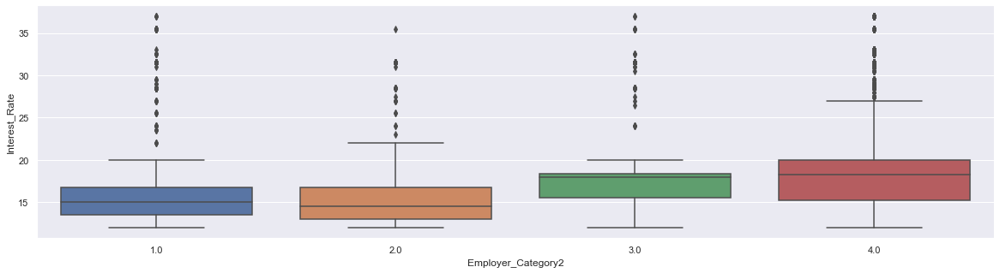

In [262]:
plt.figure(figsize=[20,5])
sns.boxplot(x='Employer_Category2',y='Interest_Rate',data=df2)
plt.show()

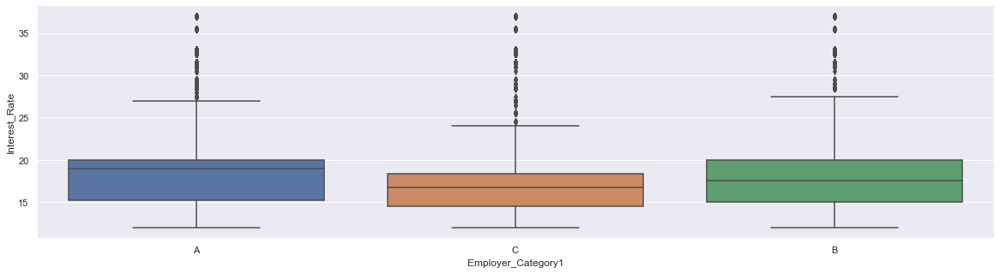

In [263]:
plt.figure(figsize=[20,5])
sns.boxplot(x='Employer_Category1',y='Interest_Rate',data=df2)
plt.show()

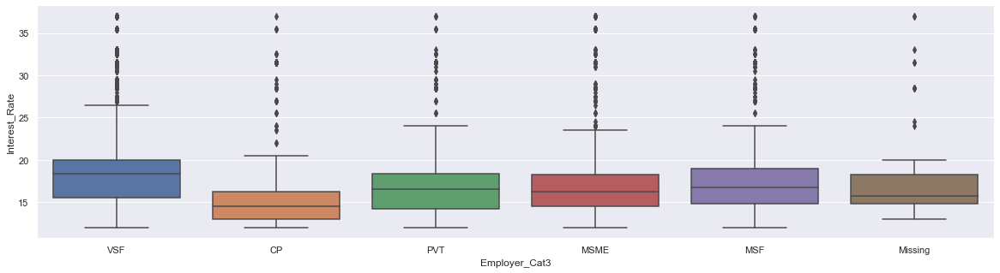

In [264]:
plt.figure(figsize=[20,5])
sns.boxplot(x='Employer_Cat3',y='Interest_Rate',data=df2)
plt.show()

In [265]:
df2.Interest_Rate.describe()

count    22276.000000
mean        19.213570
std          5.847136
min         11.990000
25%         15.250000
50%         18.000000
75%         20.000000
max         37.000000
Name: Interest_Rate, dtype: float64

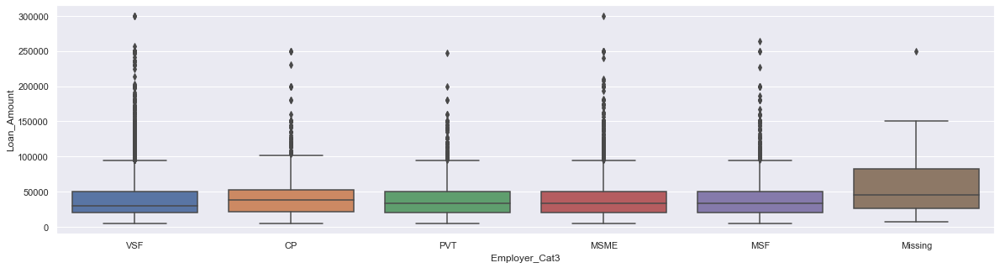

In [266]:
plt.figure(figsize=[20,5])
sns.boxplot(x='Employer_Cat3',y='Loan_Amount',data=df2)
plt.show()

In [267]:
df2.groupby('Employer_Cat3')['Loan_Amount'].mean().sort_values(ascending=False)

Employer_Cat3
Missing    56701.923077
CP         45496.331463
MSME       42590.560000
MSF        41039.892825
PVT        41023.035230
VSF        37908.309355
Name: Loan_Amount, dtype: float64

In [268]:
df2.groupby('Employer_Cat3')['Loan_Amount'].median().sort_values(ascending=False)

Employer_Cat3
Missing    46000.0
CP         38000.0
MSME       34000.0
PVT        34000.0
MSF        33000.0
VSF        30000.0
Name: Loan_Amount, dtype: float64

In [269]:
df2.groupby('Employer_Cat3')['Loan_Period'].mean().sort_values(ascending=False)

Employer_Cat3
Missing    4.105769
PVT        4.010163
MSME       3.930560
MSF        3.892230
CP         3.877859
VSF        3.875746
Name: Loan_Period, dtype: float64

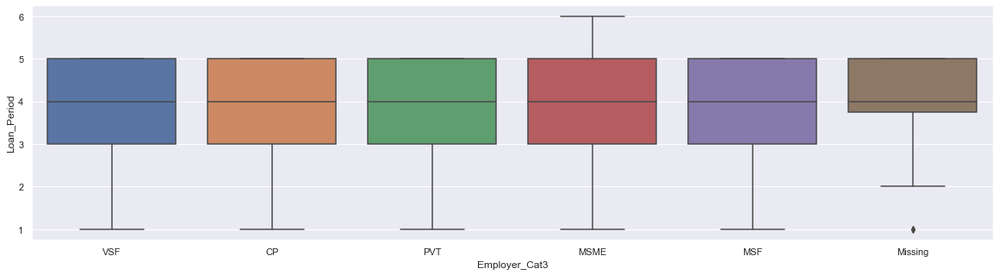

In [270]:
plt.figure(figsize=[20,5])
sns.boxplot(x='Employer_Cat3',y='Loan_Period',data=df2)
plt.show()

In [271]:
df2.loc[df2.Loan_Period==1,['Interest_Rate']].Interest_Rate.describe()

count    910.000000
mean      18.172604
std        5.649099
min       12.990000
25%       14.850000
50%       15.500000
75%       20.000000
max       37.000000
Name: Interest_Rate, dtype: float64

In [272]:
df2.Interest_Rate.describe()

count    22276.000000
mean        19.213570
std          5.847136
min         11.990000
25%         15.250000
50%         18.000000
75%         20.000000
max         37.000000
Name: Interest_Rate, dtype: float64

In [273]:
df2.loc[(df2.Loan_Period==1) & (df2.Interest_Rate==37)]

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month,Yeo_Scaled_Income,Age_Cat,Employer_Cat3
38796,APPK10705005628,Male,C10058,C,COM0023938,A,4.0,1750.0,B003,G,Y,S159,B,0.0,5000.0,1.0,37.0,505.0,2,0,26.0,8,11.466158,Middle-Aged,VSF
38958,APPD50606282731,Male,C10037,B,COM0026254,A,4.0,1500.0,B010,G,Y,S133,B,0.0,8000.0,1.0,37.0,808.0,2,0,24.0,8,11.124772,Young,VSF
40906,APPL80400829915,Male,C10035,C,COM0051170,B,4.0,1800.0,B002,P,Y,S159,B,0.0,10000.0,1.0,37.0,1010.0,2,0,29.0,8,11.529163,Middle-Aged,VSF
41834,APPE80801441603,Male,C10181,C,COM0019694,A,4.0,1250.0,<bound method Series.mode of 5 B014\n7 ...,G,Y,S133,B,0.0,5000.0,1.0,37.0,505.0,2,0,38.0,8,10.728283,Middle-Aged,VSF
45238,APPF70402085532,Male,C10032,C,COM0032810,A,4.0,1000.0,<bound method Series.mode of 0 B001\n1 ...,G,Y,S122,G,1.2,5000.0,1.0,37.0,505.0,2,0,30.0,2,10.253563,Middle-Aged,VSF
46919,APPK80098543648,Male,C10033,C,COM0011648,A,4.0,1200.0,B001,P,Y,S122,G,0.0,8000.0,1.0,37.0,808.0,0,0,31.0,3,10.640577,Middle-Aged,VSF
47752,APPN80794165904,Male,C10057,C,COM0003917,A,4.0,1500.0,B022,G,Y,S122,G,50.0,8000.0,1.0,37.0,808.0,2,0,55.0,4,11.124772,Aged,VSF
54797,APPX20857365532,Male,C10126,C,COM0033723,A,4.0,1500.0,B013,G,Y,S122,G,350.0,5000.0,1.0,37.0,505.0,2,0,24.0,9,11.124772,Young,VSF
58601,APPD20063546709,Female,C10042,C,COM0004937,B,4.0,1500.0,B031,G,Y,S122,G,0.0,8000.0,1.0,37.0,808.0,2,0,30.0,9,11.124772,Middle-Aged,VSF
67903,APPZ50252876544,Female,C10076,C,COM0000042,C,3.0,1500.0,B007,G,Y,S122,G,0.0,5000.0,1.0,37.0,505.0,2,0,21.0,9,11.124772,Young,PVT


In [274]:
df2.Gender.value_counts()

Male      39949
Female    29764
Name: Gender, dtype: int64

In [275]:
df2.groupby('Gender')['Interest_Rate'].median()

Gender
Female    18.0
Male      18.0
Name: Interest_Rate, dtype: float64

<AxesSubplot:xlabel='Gender', ylabel='Interest_Rate'>

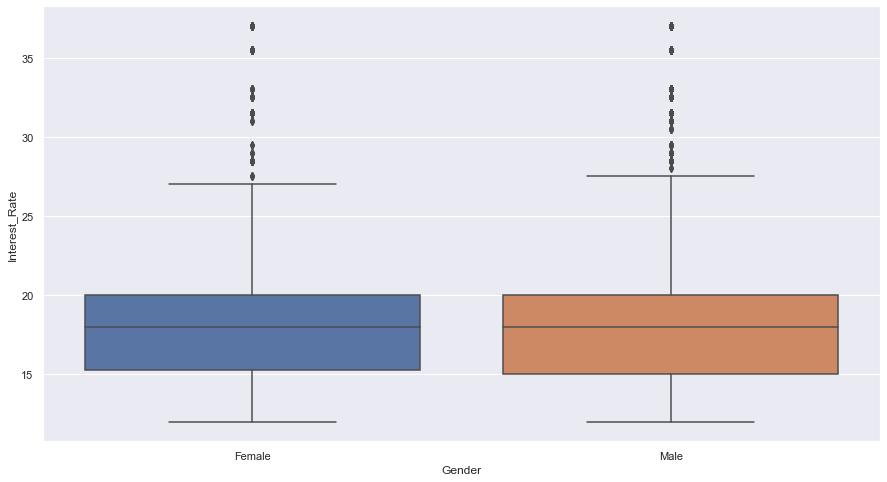

In [276]:
sns.boxplot(x = 'Gender', y = 'Interest_Rate', data= df2)

In [277]:
df2.groupby('Gender')['Loan_Amount'].median()

Gender
Female    30000.0
Male      30000.0
Name: Loan_Amount, dtype: float64

<AxesSubplot:xlabel='Gender', ylabel='Loan_Amount'>

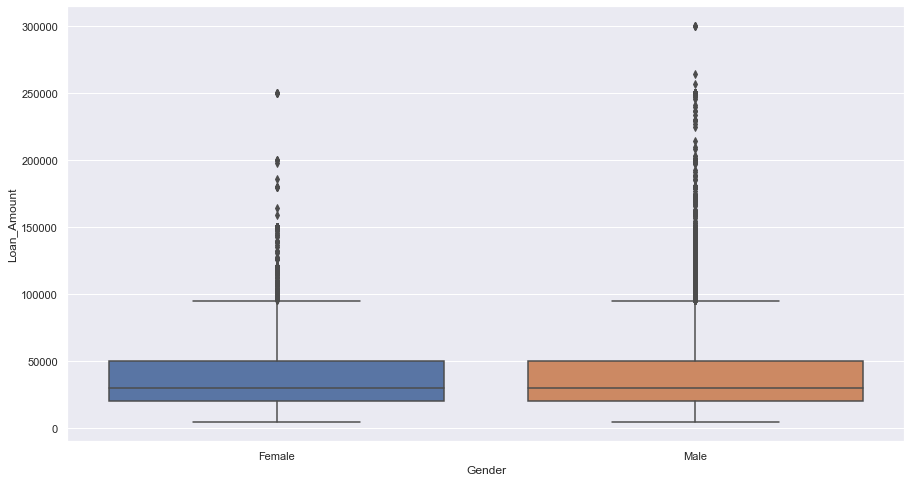

In [278]:
sns.boxplot(x = 'Gender', y = 'Loan_Amount', data= df2)  

In [279]:
df2.groupby('Gender')['EMI'].median()

Gender
Female    981.0
Male      928.0
Name: EMI, dtype: float64

<AxesSubplot:xlabel='Gender', ylabel='EMI'>

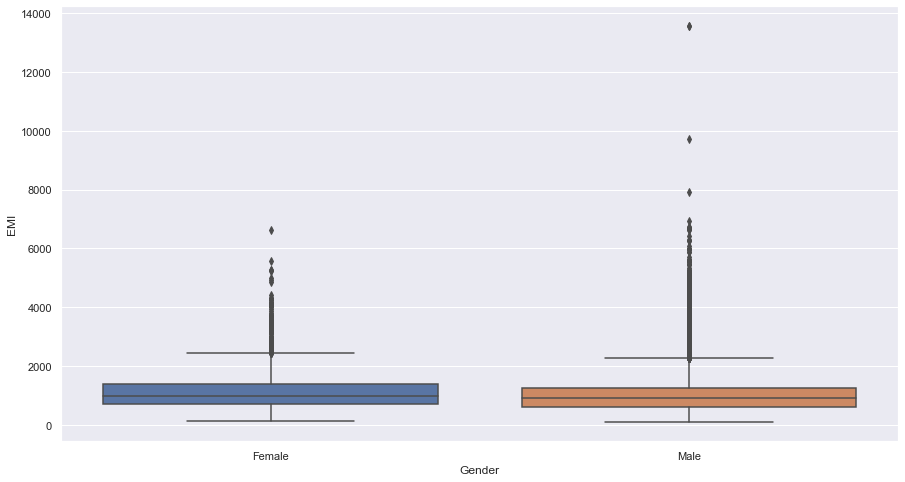

In [280]:
sns.boxplot(x = 'Gender', y = 'EMI', data= df2)  

In [281]:
df2.groupby('Gender')['Existing_EMI'].median()

Gender
Female    0.0
Male      0.0
Name: Existing_EMI, dtype: float64

<AxesSubplot:xlabel='Gender', ylabel='Existing_EMI'>

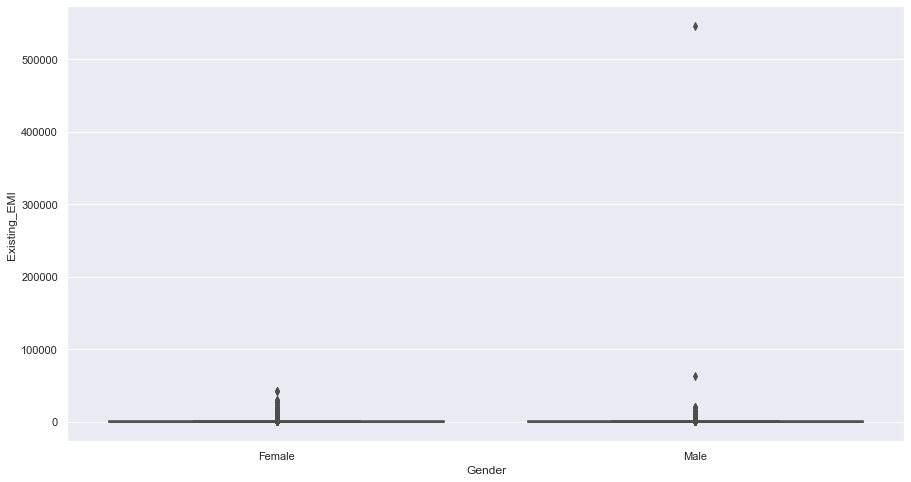

In [282]:
sns.boxplot(x = 'Gender', y = 'Existing_EMI', data= df2)  

In [283]:
df2.Monthly_Income.max()

38383838.3

#### Richest Guy in the lot

In [284]:
df2.loc[df2.Monthly_Income==38383838.3,['Gender','Approved','Loan_Amount','Interest_Rate','EMI','Existing_EMI','Employer_Category1','Employer_Category2','Employer_Cat3','City_Code','City_Category','Source','Source_Category','Age','Employer_Code']]

,Gender,Approved,Loan_Amount,Interest_Rate,EMI,Existing_EMI,Employer_Category1,Employer_Category2,Employer_Cat3,City_Code,City_Category,Source,Source_Category,Age,Employer_Code
38774,Male,0,150000.0,13.5,4061.0,0.0,A,4.0,VSF,C10001,A,S122,C,30.0,COM0034525


In [285]:
df2.columns

Index(['ID', 'Gender', 'City_Code', 'City_Category', 'Employer_Code',
       'Employer_Category1', 'Employer_Category2', 'Monthly_Income',
       'Customer_Existing_Primary_Bank_Code', 'Primary_Bank_Type', 'Contacted',
       'Source', 'Source_Category', 'Existing_EMI', 'Loan_Amount',
       'Loan_Period', 'Interest_Rate', 'EMI', 'Var1', 'Approved', 'Age',
       'Lead_Creation_Month', 'Yeo_Scaled_Income', 'Age_Cat', 'Employer_Cat3'],
      dtype='object')

In [286]:
df2.shape

(69713, 25)

#### Checking relationships with Target

<AxesSubplot:xlabel='Approved', ylabel='Loan_Amount'>

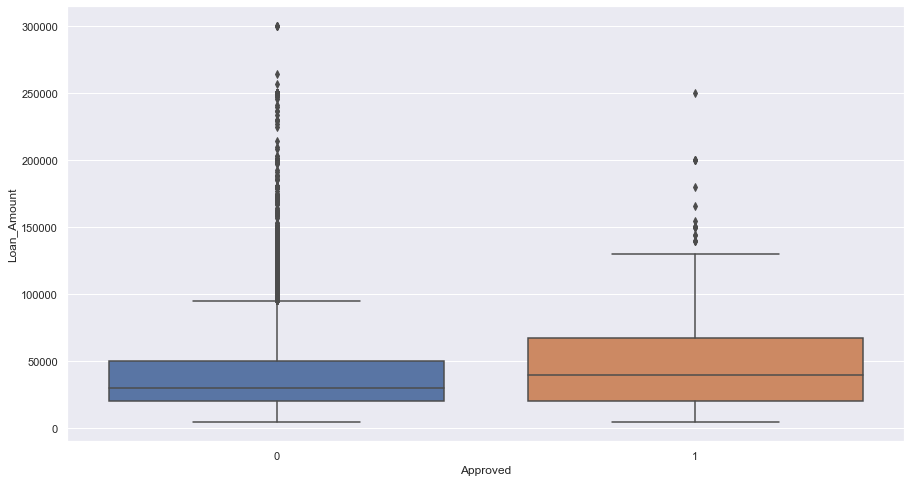

In [287]:
sns.boxplot(y = 'Loan_Amount', x ='Approved' , data = df2)
                      ## Higher scale of loans approved

<AxesSubplot:xlabel='Approved', ylabel='Monthly_Income'>

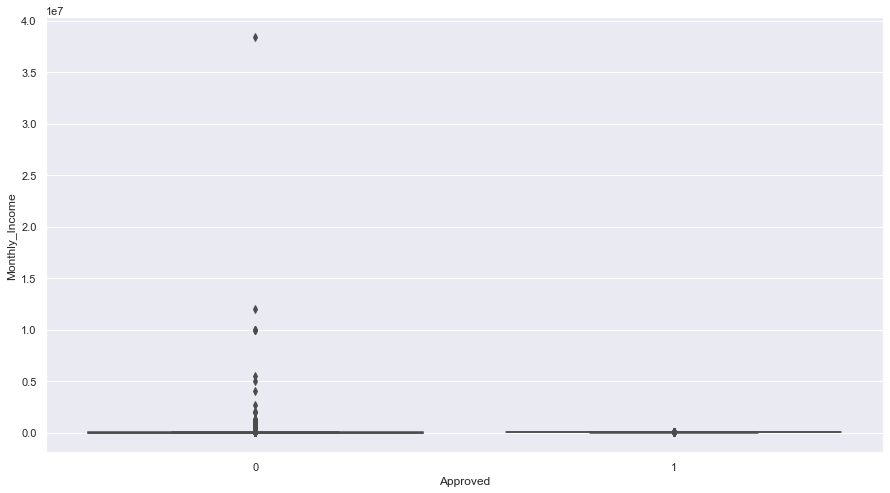

In [288]:
sns.boxplot(y = 'Monthly_Income', x ='Approved' , data = df2)  ##Lower Income given loans


<AxesSubplot:xlabel='Approved', ylabel='Yeo_Scaled_Income'>

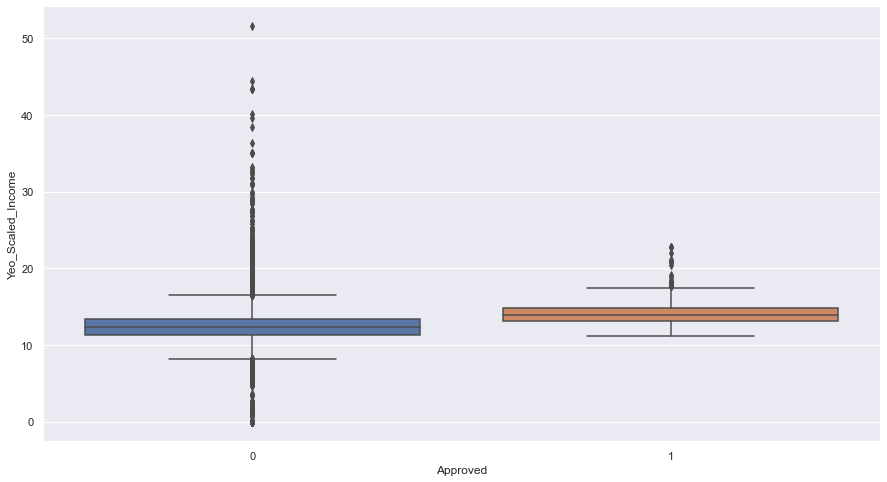

In [289]:
sns.boxplot(y = 'Yeo_Scaled_Income', x ='Approved' , data = df2)


<AxesSubplot:xlabel='Approved', ylabel='Loan_Period'>

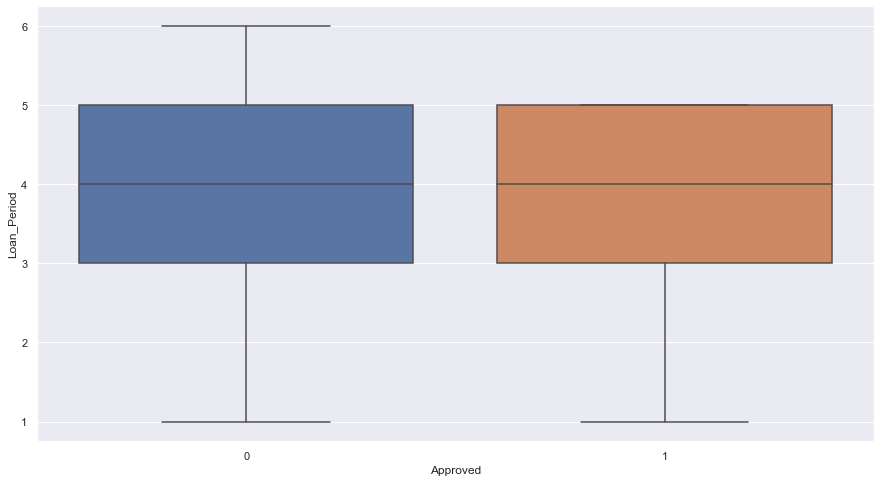

In [290]:
sns.boxplot(y = 'Loan_Period', x ='Approved' , data = df2)


In [291]:
## No effect of Loan Period on Approved rate as of now.

In [293]:
df2.Monthly_Income.describe()

count    6.971300e+04
mean     5.622283e+03
std      1.747671e+05
min      0.000000e+00
25%      1.650000e+03
50%      2.500000e+03
75%      4.000000e+03
max      3.838384e+07
Name: Monthly_Income, dtype: float64

In [294]:
df2.Monthly_Income.sort_values(ascending = False)

38774    38383838.3
20442    12010013.2
22432    10000000.0
54437    10000000.0
68021    10000000.0
22509    10000000.0
3491      5495454.5
40108     5000000.0
25179     4000078.5
24171     2626262.6
30438     2000000.0
20920     2000000.0
33319     2000000.0
39787     2000000.0
63509     1350000.0
8834      1300000.0
11027     1200000.0
31505     1170000.0
38013     1111111.1
4772      1000000.0
22497     1000000.0
6944      1000000.0
22709      859565.6
27490      833383.8
27794      800000.0
62689      650000.0
22769      610000.0
38031      562626.6
21409      530002.0
58746      530000.0
69227      500000.9
42387      500000.0
68385      500000.0
58777      468400.0
40212      450000.0
27612      380000.0
19498      363636.6
21209      360000.0
69476      350000.0
28903      333333.3
37326      300000.0
25450      300000.0
38021      262626.6
32335      256262.6
20848      250000.0
8763       230100.0
9049       200000.0
4525       200000.0
46593      200000.0
59208      196000.0


In [295]:
df2.head()

,ID,Gender,City_Code,City_Category,Employer_Code,Employer_Category1,Employer_Category2,Monthly_Income,Customer_Existing_Primary_Bank_Code,Primary_Bank_Type,Contacted,Source,Source_Category,Existing_EMI,Loan_Amount,Loan_Period,Interest_Rate,EMI,Var1,Approved,Age,Lead_Creation_Month,Yeo_Scaled_Income,Age_Cat,Employer_Cat3
0,APPC90493171225,Female,C10001,A,COM0044082,A,4.0,2000.0,B001,P,N,S122,G,0.0,NaN,NaN,NaN,NaN,0,0,37.0,7,11.766516,Middle-Aged,VSF
1,APPD40611263344,Male,C10003,A,COM0000002,C,1.0,3500.0,B002,P,Y,S122,G,0.0,20000.0,2.0,13.25,953.0,10,0,30.0,4,13.073505,Middle-Aged,CP
2,APPE70289249423,Male,C10125,C,COM0005267,C,4.0,2250.0,B003,G,Y,S143,B,0.0,45000.0,4.0,NaN,NaN,0,0,34.0,7,12.035074,Middle-Aged,VSF
3,APPF80273865537,Male,C10477,C,COM0004143,A,4.0,3500.0,B003,G,Y,S143,B,0.0,92000.0,5.0,NaN,NaN,7,0,27.0,9,13.073505,Middle-Aged,VSF
4,APPG60994436641,Male,C10002,A,COM0001781,A,4.0,10000.0,B001,P,Y,S134,B,2500.0,50000.0,2.0,NaN,NaN,10,0,31.0,7,15.748777,Middle-Aged,VSF


In [296]:
pd.crosstab(df2.Age_Cat,df2.Approved)

Approved,0,1
Age_Cat,,
Aged,6273,116
Middle-Aged,47289,831
Old,137,1
Young,14994,72


In [297]:
6273/116

54.077586206896555

In [298]:
47289/831

56.90613718411552

In [299]:
14994/72

208.25

In [300]:
df2.Age_Cat.value_counts()

Middle-Aged    48120
Young          15066
Aged            6389
Old              138
Name: Age_Cat, dtype: int64

In [311]:
(df2.isnull().sum()/df2.shape[0])*100

ID                                      0.000000
Gender                                  0.000000
City_Code                               1.167644
City_Category                           0.000000
Employer_Code                           5.763631
Employer_Category1                      0.000000
Employer_Category2                      0.000000
Monthly_Income                          0.000000
Customer_Existing_Primary_Bank_Code     0.000000
Primary_Bank_Type                       0.000000
Contacted                               0.000000
Source                                  0.000000
Source_Category                         0.000000
Existing_EMI                            0.000000
Loan_Amount                            39.747249
Loan_Period                            39.747249
Interest_Rate                          68.046132
EMI                                    68.046132
Var1                                    0.000000
Approved                                0.000000
Age                 

In [302]:
df2.std()

Employer_Category2          0.784980
Monthly_Income         174767.061840
Existing_EMI             2287.701470
Loan_Amount             30727.595990
Loan_Period                 1.167491
Interest_Rate               5.847136
EMI                       752.661394
Var1                        3.819214
Approved                    0.120073
Age                         7.086129
Lead_Creation_Month         2.385547
Yeo_Scaled_Income           2.009691
dtype: float64

In [304]:
df2[df2.Monthly_Income<5].shape

(346, 25)

In [305]:
346/70000

0.004942857142857143

In [313]:
df2.loc[df2.Monthly_Income<5][['Age','Employer_Code','Age_Cat','Approved','Employer_Cat3','Monthly_Income']]

,Age,Employer_Code,Age_Cat,Approved,Employer_Cat3,Monthly_Income
562,29.0,COM0000087,Middle-Aged,0,MSME,1.5
1357,32.0,COM0000015,Middle-Aged,0,CP,2.0
1376,25.0,COM0000002,Young,0,CP,2.3
1377,25.0,COM0000002,Young,0,CP,2.3
1530,30.0,COM0005816,Middle-Aged,0,VSF,3.5
1531,30.0,COM0005816,Middle-Aged,0,VSF,3.5
2278,29.0,COM0000002,Middle-Aged,0,CP,2.1
2415,30.0,COM0000948,Middle-Aged,0,MSF,2.2
4098,35.0,COM0000109,Middle-Aged,0,MSME,2.5
7162,33.0,COM0000024,Middle-Aged,0,PVT,3.5
